In [16]:
import networkx as nx
import pandas as pd
import numpy as np
import json
import matplotlib.patches as patches
import matplotlib.pyplot as plt
from node2vec import Node2Vec
from gensim.models import Word2Vec


In [2]:
with open('./Train_with_mongo_tree.json', 'r') as file:
    df = json.load(file)

In [3]:
len(df)

56111

In [4]:
df_with_tree = []

In [5]:
# # extract the natural language questions and  schema information
# questions = [item[1] for item in df]


In [71]:
df_no = 0
count = 0
count_db = 0

# Unique nodes dictionary
db_vocab = {}

# For storing unique edge lists
edge_list = []

# For storing unique trees
uniq_tree_list = []

# # For storing all the graphs in the dataset
# all_graphs = []

for df_no in range(1):
    # Store trees corresponding to query
    tree_list = []

    count_dups = 0
    prev_word = df[0][2]["header"][1]

    total_datasets = len(df)

    for i in range(total_datasets):

        # Compare column name with the column name of the next column name of dataset
        try:
            if df[i + 1][2]["header"][1] != prev_word:

                trees = []
                # Unique database name
                db_name = 'table_' + str(count_db)

                # Add unique db name to vocab
                db_vocab[count] = db_name
                count_db += 1

                # Store index of unique db name
                src_val = count
                count += 1

                for j in df[i][2]["header"]:
                    db_vocab[count] = j

                    # Append new edge and tree
                    edge_list.append([src_val, count])
                    trees.append([src_val, count])
                    count += 1

                # Unique tree list
                uniq_tree_list.append(trees)

                # Append tree corresponding to the query
                for k in range(count_dups + 1):
                    tree_list.append(trees)
                # Reset duplicate counts and previous column name
                count_dups = 0
                prev_word = df[i + 1][2]["header"][1]

            else:
                count_dups = count_dups + 1

        except:
            trees = []
            # Unique database name
            db_name = 'table_' + str(count_db)

            # Add unique db name to vocab
            db_vocab[count] = db_name
            count_db += 1

            # Store index of unique db name
            src_val = count
            count += 1

            for j in df[i][2]["header"]:
                db_vocab[count] = j

                # Append new edge and tree
                edge_list.append([src_val, count])
                trees.append([src_val, count])
                count += 1

            # Unique tree list
            uniq_tree_list.append(trees)

            # Append tree corresponding to the query
            for k in range(count_dups + 1):
                tree_list.append(trees)
            # Reset duplicate counts and previous column name
            count_dups = 0

    # Change dict index to value stored in dict
    for i, tree_edges in enumerate(tree_list):
        G = nx.Graph()
        for edge in tree_edges:
            G.add_edge(db_vocab[edge[0]], db_vocab[edge[1]])
        tree_list[i] = G


    # Append all graphs in the dataset
    # all_graphs.append(tree_list)

# Now, 'all_graphs' contains all the graphs in the dataset


In [83]:
print(uniq_tree_list[-1])

[[118503, 118504], [118503, 118505], [118503, 118506], [118503, 118507], [118503, 118508], [118503, 118509]]


In [69]:
# df_no=0
# count=0
# count_db=0

# #unique nodes dictionary
# db_vocab={}
# #for store unique edge list
# edge_list=[]
# #for store unique trees
# uniq_tree_list=[]

# for df_no in range(1):
#     #store trees corresponding to query
#     tree_list=[]
    
#     count_dups=0
#     prev_word=df[0][2]["header"][1]
    
#     total_datasets=len(df)
    
#     for i in range(total_datasets):
        
#         #compare column name with the column name of next column name of dataset 'or' condition for the last remaining database
#         try:
#             if df[i+1][2]["header"][1] != prev_word:
            
#                 trees=[]
#                 #unique database name
#                 db_name='table_'+str(count_db)
                
#                 #add unique db name to vocab
#                 db_vocab[count] = db_name
#                 count_db=count_db+1
                
#                 #store index of unique db name
#                 src_val=count
#                 count=count+1
                
#                 for j in df[i][2]["header"]:  
                    
#                     db_vocab[count] = j
                        
#                     #append new edge and tree
#                     edge_list.append([src_val, count])
#                     trees.append([src_val, count])
#                     count=count+1
                    
#                 #unique tree list
#                 uniq_tree_list.append(trees)
                
#                 #append tree corresponding to the query
#                 for k in range(count_dups+1):
#                     tree_list.append(trees)
#                 #reset duplicate counts and previous column name
#                 count_dups=0
#                 prev_word=df[i+1][2]["header"][1]
                    
#             else:
#                 count_dups=count_dups+1
                
#         except:
#             trees=[]
#             #unique database name
#             db_name='table_'+str(count_db)
            
#             #add unique db name to vocab
#             db_vocab[count] = db_name
#             count_db=count_db+1
            
#             #store index of unique db name
#             src_val=count
#             count=count+1
            
#             for j in df[i][2]["header"]:  
                
#                 db_vocab[count] = j
                    
#                 #append new edge and tree
#                 edge_list.append([src_val, count])
#                 trees.append([src_val, count])
#                 count=count+1
                
#             #unique tree list
#             uniq_tree_list.append(trees)
            
#             #append tree corresponding to the query
#             for k in range(count_dups+1):
#                 tree_list.append(trees)
#             #reset duplicate counts and previous column name
#             count_dups=0
    
#     # change dict index to value stored in dict
#     for i in enumerate(tree_list):
#         G = nx.from_edgelist(i[1])
#         H = nx.relabel_nodes(G, db_vocab)
#         tree_list[i[0]]=list(H.edges())
    
#     for i,row in enumerate(df):
#         row.append(tree_list[i])

In [ ]:
# print(tree_list)

In [73]:
# take max number of column in the wikisql dataset which is 44 
# and drop datas which have column greater than 15

maxlen = 0
len_of_columns = []
long = []

for i,each in enumerate(uniq_tree_list):
    
    len_of_columns.append(len(each))
    
    if len(each) > 15:
            long.append(i)
    if (len(each) > maxlen):
        maxlen = len(each)
    else:  
        continue
        
long.sort(reverse = True)
print(len(long),maxlen)

59 44


In [74]:
sum(np.array(len_of_columns) > 15 )

59

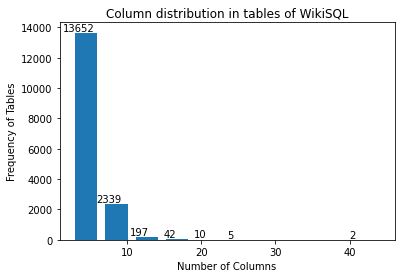

In [75]:
plt.title('Column distribution in tables of WikiSQL')
n,bins,patches = plt.hist(len_of_columns, width= 3)

for i, count in enumerate(n):
    if count > 0:
        plt.text(bins[i] + 0.5, count, str(int(count)),
                 ha='center', va='bottom')

plt.xlabel('Number of Columns')
plt.ylabel('Frequency of Tables')
plt.show()

In [76]:
# dropping datas which have too many columns

for a in long:
    df.pop(a)
print(len(df))

55993


In [ ]:
df[:5]

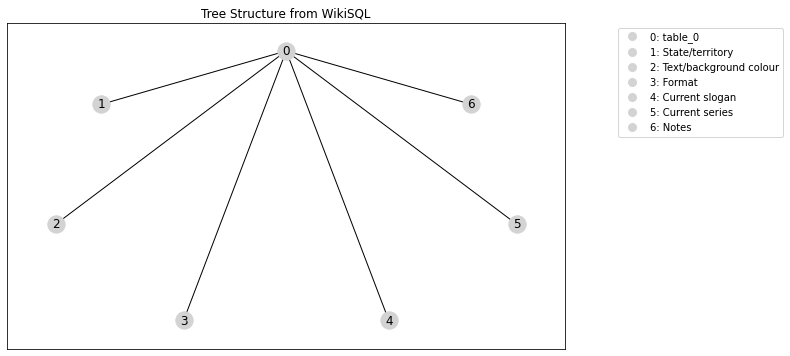

In [86]:
#taking  a single graph from the list of graphs

plt.figure(figsize=(10,6))

G = nx.Graph(nx.from_edgelist(uniq_tree_list[0]))

nodes = list(nx.from_edgelist(df[0][-1]))

pos = nx.shell_layout(G)

pos_rotated = {node: [coord[1], -coord[0]] for node, coord in pos.items()}

nx.draw_networkx(G, pos_rotated, node_color='lightgray')

labels = {i: node for i, node in enumerate(nodes)}

handles = [plt.Line2D([0], [0], marker='o', color='w', markerfacecolor='lightgray', markersize=10)] * len(nodes)
legend_labels = [f'{i}: {labels[i]}' for i in range(len(nodes))]
plt.legend(handles, legend_labels, loc='upper right',bbox_to_anchor=(1.4, 1))

plt.title('Tree Structure from WikiSQL')
plt.show()

In [28]:
print(G)

Graph with 7 nodes and 6 edges


In [30]:
for node, attributes in H.nodes(data=True):
    print(f"Node: {node}, Attributes: {attributes}")

Node: table_16246, Attributes: {}
Node: Name, Attributes: {}
Node: Circuit, Attributes: {}
Node: Date, Attributes: {}
Node: Winning driver, Attributes: {}
Node: Winning constructor, Attributes: {}
Node: Report, Attributes: {}


In [87]:
# List to store embeddings for each graph
graph_embeddings = []

# Create a Node2Vec model
for graph in tree_list:
    node2vec = Node2Vec(
        graph,  
        dimensions=512,  # Number of dimensions for embeddings
        walk_length=10,  # Length of random walks
        num_walks=30,  # Number of random walks per node
        )

    # Generate embeddings using the Node2Vec model
    model = node2vec.fit(window=5, min_count=1)  # Fit the model and set hyperparameters

    # Get the embeddings for all nodes
    node_embeddings = { str(node): model.wv[str(node)] for node in model.wv.index_to_key}
    graph_embeddings.append(node_embeddings)

Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6203.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7259.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5630.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6344.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7000.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7531.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7142.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7043.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6904.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6704.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5889.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6125.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7263.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7857.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8324.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6094.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7008.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5497.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5781.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7150.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7827.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6256.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7300.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7059.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6997.50it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.97it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.81it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3280.56it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2919.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10018.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7884.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9586.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8869.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5316.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6827.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4033.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4388.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5687.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5851.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7321.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6423.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5366.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7092.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7137.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5760.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6434.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6728.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6581.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4470.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5258.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7514.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6758.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5714.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5767.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5547.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.64it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3774.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5899.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4708.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4489.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7298.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6227.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5460.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2382.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6180.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6107.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7083.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9072.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7219.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6802.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5806.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6562.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6411.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6831.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5018.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2596.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6351.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5415.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5823.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6019.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7288.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9941.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9063.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7080.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6914.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8422.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8075.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9147.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9139.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5750.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5718.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6111.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5686.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6497.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4771.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4124.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8741.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7246.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6721.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8262.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4234.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7527.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6563.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5017.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5076.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6707.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7224.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6865.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7072.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6770.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9520.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8621.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6943.45it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.49it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3392.17it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.17it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.00it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2317.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2649.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6786.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6740.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5713.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4525.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5621.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4692.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5616.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5653.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4721.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4633.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5815.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.09it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3413.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4895.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5612.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4898.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3188.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4515.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5015.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5748.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9703.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7012.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7136.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4814.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4877.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4849.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5493.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5755.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6074.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5457.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8105.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7298.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5588.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7020.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9979.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7236.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4790.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4921.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4751.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7067.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5469.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7722.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7173.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7248.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4581.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.66it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3839.53it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3192.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9549.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5597.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5559.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5496.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5729.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5647.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7037.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7280.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7401.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6468.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7093.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6346.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6765.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8343.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4353.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4549.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5215.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7893.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6225.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7305.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9927.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5349.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5278.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2352.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5107.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4900.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6245.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5922.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5644.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6117.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2704.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2562.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4924.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4116.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6259.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9058.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8630.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7713.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5668.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6524.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9354.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4490.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7748.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6905.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5310.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3232.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4547.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2893.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5710.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5248.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5282.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5481.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4645.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4947.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4512.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6554.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6436.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6507.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6405.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5532.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5056.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3193.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6957.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6490.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7090.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2106.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7337.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4323.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8248.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4945.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4518.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3239.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6510.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5813.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6722.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9946.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8064.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7358.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8084.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8255.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8232.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9935.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7034.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6773.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6965.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7448.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7410.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8309.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7283.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8480.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5125.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5745.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5661.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8994.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9340.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7404.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8594.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4053.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9969.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5566.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6513.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8360.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3655.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3628.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4197.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5765.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5324.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5869.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5067.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5718.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5332.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4661.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5831.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7838.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6923.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.61it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5831.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6349.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7126.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8558.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5224.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4326.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4894.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5134.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6203.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6719.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6844.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4915.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6342.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5757.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6339.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6895.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7019.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6321.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5277.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8886.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6550.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5766.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5580.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6516.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5725.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6935.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5487.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6225.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4659.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3339.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.06it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2611.21it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7260.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6978.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4544.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3248.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6153.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6251.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5288.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2422.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9174.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9981.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7239.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7638.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4515.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3718.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4454.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3090.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3707.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5394.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5253.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5708.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5926.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6831.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6922.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3026.34it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3054.18it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2614.74it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.83it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3926.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5687.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6587.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4109.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2954.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3569.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3117.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3891.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4459.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4675.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4754.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4061.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4126.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5808.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6837.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6824.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3947.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5060.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4859.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2685.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4532.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4208.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4156.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4425.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4530.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6330.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6284.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4026.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4362.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2283.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3830.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3425.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2956.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4400.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4512.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4927.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3935.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7433.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7268.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6597.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8320.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7945.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6320.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8397.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6741.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5591.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5109.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6346.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2945.44it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.68it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8086.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8062.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9858.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8141.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3957.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6561.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6576.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5621.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5826.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6674.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5766.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8605.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6938.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7294.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7283.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6830.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6735.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6019.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8370.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7749.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5788.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5782.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8348.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6354.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6770.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6798.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5675.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5107.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5745.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4507.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5902.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3247.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3051.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5924.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6615.27it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.08it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3052.92it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.41it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5296.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8279.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6252.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5116.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2641.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5138.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6396.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7326.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6165.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6513.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6957.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6337.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5757.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5795.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5469.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5868.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6231.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6470.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5008.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6356.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6055.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5790.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6152.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7559.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7207.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6486.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3449.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6297.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7803.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7054.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6460.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6869.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5248.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6045.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4653.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6835.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10016.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6351.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7530.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6361.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5587.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6846.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7394.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4234.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6997.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6671.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10013.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5683.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10022.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7986.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7249.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7131.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6453.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7264.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8133.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7274.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9969.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9950.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8250.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6954.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6954.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9360.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6850.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9831.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9470.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6687.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7335.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7626.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6995.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7130.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8607.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6865.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7141.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5577.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8089.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6247.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7178.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7854.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8141.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3670.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7781.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2276.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4686.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3343.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7123.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5504.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6174.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7191.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6861.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4891.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5338.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4455.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7173.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5783.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5298.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5346.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5361.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7298.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6745.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5512.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5226.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5646.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5112.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3069.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7218.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6430.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5820.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7399.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7172.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4039.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6327.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5281.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4855.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4633.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3563.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2177.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3341.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5169.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3172.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2788.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4927.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3905.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3427.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4465.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2857.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3005.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2370.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4047.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3427.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4356.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3218.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3926.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7598.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5533.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6667.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4248.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4115.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7192.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5502.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6056.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8028.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6471.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6396.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3291.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6448.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5555.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5178.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7101.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8825.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7332.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8339.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7753.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7302.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6711.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7698.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6072.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7565.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5843.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9409.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5471.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6299.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7359.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6757.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5817.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7366.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7349.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7098.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6133.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6305.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8686.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6689.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5723.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5968.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4820.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7143.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8605.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5661.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6157.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7249.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9631.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7882.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6295.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7824.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7231.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4717.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7280.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8518.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7437.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5664.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3857.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7245.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6024.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4840.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7388.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5418.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7579.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5374.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5717.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5348.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6557.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5641.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5512.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6750.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7759.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6782.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6102.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3954.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3613.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7018.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7008.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6442.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6084.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7156.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6379.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4661.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4059.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8130.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7333.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6750.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2930.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6907.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6667.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6496.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8124.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6417.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7434.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2803.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3412.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7268.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6477.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5748.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5585.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7369.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6673.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7442.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3952.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3635.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5600.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5639.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5030.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5867.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5896.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5370.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5308.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5566.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6807.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7262.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5487.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8468.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5663.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3676.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2377.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4818.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4793.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5020.51it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.63it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7166.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3636.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5789.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3835.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5098.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4787.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5354.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4649.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2492.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8215.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3090.49it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1968.17it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2675.79it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3163.76it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3041.26it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.20it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3082.61it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3376.97it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3199.40it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2887.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.32it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.97it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2937.80it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.91it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.85it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2883.41it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3676.10it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.57it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6411.35it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.25it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1931.20it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3020.82it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.29it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2567.63it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.23it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2230.54it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2382.00it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3243.52it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3354.46it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.19it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3285.44it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3232.02it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2326.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3708.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7315.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5643.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8130.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7257.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6987.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5635.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6505.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6930.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5215.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6479.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6781.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5520.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2416.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6418.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6329.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7971.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5376.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3764.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3475.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6470.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3953.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7139.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5745.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9978.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7339.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4359.98it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2357.68it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.81it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8268.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8223.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9464.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3940.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4531.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5258.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7258.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6129.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6020.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5791.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2408.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4398.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4930.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5531.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4756.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7256.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4782.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6712.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5537.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6886.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5895.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5772.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5804.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4695.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5659.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8282.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3466.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4191.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4103.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6456.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4636.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5503.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4624.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6197.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6718.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5414.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5838.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3496.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.77it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2912.98it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2656.92it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2927.55it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3164.64it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3249.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4503.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4741.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7307.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7334.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6927.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4417.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6254.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5829.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6404.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5673.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6140.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7964.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5606.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6875.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6064.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6181.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5801.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7618.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7300.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7106.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6495.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6514.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6521.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5676.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5585.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5466.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5008.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4531.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6575.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3161.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5786.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8100.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7978.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7275.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7002.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6129.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5844.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6790.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9766.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6510.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8404.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6498.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6566.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9511.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7251.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5920.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6723.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8569.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6679.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7162.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7989.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6908.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5831.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5789.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6725.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4915.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8872.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6700.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5520.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7047.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6228.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5725.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8188.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5821.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5551.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6165.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7286.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5864.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7414.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6178.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6798.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6284.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7350.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7186.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6881.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7018.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4649.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5549.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7136.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6090.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6739.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4926.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7435.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8024.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6354.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6241.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6326.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6522.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7351.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9066.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6475.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8020.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6487.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5633.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6871.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5174.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6792.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6251.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4908.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7077.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5852.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6903.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6384.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7392.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5574.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5898.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5928.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6303.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6802.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6355.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6143.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5931.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5575.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7044.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7635.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5577.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5650.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6528.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5256.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5716.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6923.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8156.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6920.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7264.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4473.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7065.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7010.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5722.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5290.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6341.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8079.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7164.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6176.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6319.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5879.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5517.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6361.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6396.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7283.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7296.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7194.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6862.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5551.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6697.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6501.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6419.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6723.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4853.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5705.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6710.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8260.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6288.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7298.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6165.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7167.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5601.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7030.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6798.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7296.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6800.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7221.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6984.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6094.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7390.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6312.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3417.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4233.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6017.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6353.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6126.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7248.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7699.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7096.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6386.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5608.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6143.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3177.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5695.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7049.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7170.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6126.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5128.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6538.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6086.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5747.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6922.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4677.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6822.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6284.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6032.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6199.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6443.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6751.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2288.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5918.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5751.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6182.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7631.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7192.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7108.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3180.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5836.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5793.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6415.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6062.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6430.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5600.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5899.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6193.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7219.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4408.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4509.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7209.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6794.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5814.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6165.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7030.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6399.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5392.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5082.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6349.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5878.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6378.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5322.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6706.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7103.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7335.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6985.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5820.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6712.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6970.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5650.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5597.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5528.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6317.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7159.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4791.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5703.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5504.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4768.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5151.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3824.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5688.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4077.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7192.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2753.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7063.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9994.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7002.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7393.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3232.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.68it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2440.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9418.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4660.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6510.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8995.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9977.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7073.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8234.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4116.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2200.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4330.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1764.02it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2038.44it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3390.89it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.75it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.52it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.48it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3338.17it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3048.11it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2618.39it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.52it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3348.12it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3259.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4210.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4794.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5089.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5653.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6569.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.75it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.15it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2570.67it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.15it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2673.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9975.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8098.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6856.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7098.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4835.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6211.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4647.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5466.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2408.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2897.55it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.09it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6293.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6487.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6838.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8397.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7244.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3689.68it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3345.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.63it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5543.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5584.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3077.48it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.36it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3173.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9335.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8878.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7299.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2709.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5056.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4151.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4526.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3687.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8274.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7076.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4069.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4150.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7916.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4291.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4013.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5039.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6064.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6877.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.84it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2919.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.44it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3296.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7781.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8167.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6251.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6307.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5203.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5364.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9211.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7299.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8858.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9181.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5676.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3103.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5184.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5699.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.92it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3474.79it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.28it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3343.50it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3212.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3265.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3299.74it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.98it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2891.03it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3420.76it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1898.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8168.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7323.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6994.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7378.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.74it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.64it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2953.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.34it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5676.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4416.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6140.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6305.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6928.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9297.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6708.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7071.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6681.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6402.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6162.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8047.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9942.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7397.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7193.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6924.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9576.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9001.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9875.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5170.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4489.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7856.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3760.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5385.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5663.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6378.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5712.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5859.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5210.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5564.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3361.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4911.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3099.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7441.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6083.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6435.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6736.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4577.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5461.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7130.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5140.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6338.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4090.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4721.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5282.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5644.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7040.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9497.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8565.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6181.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9960.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9939.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6345.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8291.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6392.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 14990.36it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7088.57it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5510.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6216.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6327.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3925.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5723.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4942.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4179.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3595.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5150.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4067.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4457.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5246.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6548.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4481.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9069.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8040.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7261.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5269.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5392.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5127.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3480.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5055.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5252.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7181.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6218.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6133.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7302.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9213.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7373.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7583.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6925.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6334.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2928.03it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6616.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5968.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7883.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7539.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5180.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6700.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4732.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5794.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6395.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7064.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6740.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2592.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3605.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3221.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6477.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8318.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6327.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5697.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7040.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10013.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8274.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8588.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8123.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7078.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9975.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2483.06it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2918.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3023.65it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3550.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7182.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7729.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3547.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7050.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7399.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6729.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5807.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6915.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4869.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4837.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5918.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6601.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5874.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6721.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7983.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7306.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6468.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.56it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3026.12it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2974.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.88it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3028.60it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5763.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6829.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5690.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3216.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6329.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6961.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6571.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7889.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5926.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6507.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7257.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7116.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5090.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7021.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7370.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6977.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6476.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7267.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5097.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4748.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7082.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5380.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8344.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4737.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6164.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4071.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6045.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5831.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6699.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5670.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5859.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5556.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5619.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7958.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6237.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10016.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6176.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7168.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8346.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8451.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6707.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6555.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3809.89it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.56it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3840.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.12it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2235.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3534.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4026.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3213.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7232.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7323.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5670.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5699.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7634.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8585.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5782.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5766.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7231.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5643.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4853.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4000.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5847.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6243.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5399.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5786.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6195.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5918.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5781.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5088.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6243.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6826.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4817.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5781.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3480.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6231.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9639.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9966.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8225.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7584.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7852.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6357.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9121.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 13082.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7628.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5594.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7245.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.55it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3471.44it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3876.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6091.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3898.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3881.34it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3650.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2711.60it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.94it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2884.20it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2860.21it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3183.69it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5131.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4718.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5332.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6488.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5603.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5669.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6877.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5676.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9639.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6413.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.68it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6552.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6995.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5924.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7373.09it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2819.64it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3229.29it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.20it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3191.36it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.09it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6425.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5664.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7389.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4525.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7411.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8137.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9919.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6873.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7157.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9986.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5893.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9289.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7311.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5879.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6930.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5361.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5738.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.67it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7046.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5745.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5527.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5902.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6422.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6106.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6562.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7083.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6384.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3239.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4699.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6408.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7955.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6805.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6404.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3539.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8461.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6898.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8489.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8479.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5167.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5688.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6399.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4354.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3474.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2643.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6419.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7068.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5768.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6381.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6071.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4235.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5688.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3794.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6307.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7035.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4229.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7033.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7799.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7078.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8535.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5237.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4333.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6385.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6281.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4489.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4504.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3639.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4404.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4414.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3208.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4077.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4038.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4852.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4526.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3692.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6943.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5086.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5236.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7181.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9979.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7959.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6851.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6076.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8025.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8627.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3909.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7345.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5903.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6782.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7372.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6371.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8102.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7214.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6501.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7320.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5113.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5304.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6050.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8329.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5418.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5731.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9434.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7059.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8612.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7253.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7412.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6498.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7280.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7608.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10013.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3858.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.64it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4687.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5009.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7195.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6535.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5304.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4837.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4039.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3911.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4342.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6518.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7277.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7344.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5844.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4005.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5375.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5753.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5767.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5738.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5660.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8409.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4666.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.03it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6972.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6460.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6351.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2425.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3469.81it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.57it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3248.96it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.30it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5397.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5887.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5761.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6293.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5349.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5583.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5052.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7161.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5404.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5328.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.56it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2880.18it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2272.64it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3013.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5218.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5371.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6072.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3020.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6863.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9983.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5359.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7050.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7110.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9706.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5868.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5608.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.48it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2655.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.70it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2830.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2282.20it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2588.12it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2469.17it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.94it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.40it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.40it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.56it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.13it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.48it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2751.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7007.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7425.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7417.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6507.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6822.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7239.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7281.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6366.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6857.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7036.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6760.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9202.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6338.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7016.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7209.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7175.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7686.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5890.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5631.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7216.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7427.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5316.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3544.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5523.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5586.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.51it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.73it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2339.88it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1764.91it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2419.65it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.65it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1572.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 14995.72it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 15001.09it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5871.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5201.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4038.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4304.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3832.51it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.79it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2408.86it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1974.84it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.17it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2036.89it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5097.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7322.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5846.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5237.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7327.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8554.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.60it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.19it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2680.07it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.18it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1498.57it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1733.40it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3097.41it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2633.18it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3024.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3283.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3821.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3228.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5861.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6140.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8230.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7874.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10012.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9961.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7726.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9063.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4093.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4134.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9214.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7442.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5813.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.28it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.81it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7236.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5866.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6215.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6472.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5502.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8471.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7216.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3384.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5526.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7150.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7415.23it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.53it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.34it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2588.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.73it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.27it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.90it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2227.77it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.53it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2213.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5545.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5696.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5630.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6268.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5893.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5767.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6215.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4058.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4636.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3576.72it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.81it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.17it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1851.14it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3484.41it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3440.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5167.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4390.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2833.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2292.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3384.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4921.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.81it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4495.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5541.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6348.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5162.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9627.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6358.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4545.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4030.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3906.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3904.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2643.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5614.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6415.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6297.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6616.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3940.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.33it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2299.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5631.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4794.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5272.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5193.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5759.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5279.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6246.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6763.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3757.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9958.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6243.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7241.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4483.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6388.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4692.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6356.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4549.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6680.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7329.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5753.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4382.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8433.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7036.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8118.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9975.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4300.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6296.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5083.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7006.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6381.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4521.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2559.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4730.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3593.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4465.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4328.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4311.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3490.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7243.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6078.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7015.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8793.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7286.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7410.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4033.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4466.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5343.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5085.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5666.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3619.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4242.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4561.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4055.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3480.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4817.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4624.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4519.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6793.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5842.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7406.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6767.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5098.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3296.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3837.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6467.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6386.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3379.87it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5605.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3839.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5132.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6890.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3762.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7455.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7779.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8696.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4922.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5683.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6430.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6509.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6213.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6388.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3286.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5922.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6665.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5062.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4313.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3348.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4689.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5055.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6945.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7062.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7082.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9167.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5496.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4858.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4845.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3117.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.09it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6783.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9839.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6064.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.90it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5855.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6510.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5585.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5280.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7174.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6699.45it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2864.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5469.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6542.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4391.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.74it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2368.28it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1666.83it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.20it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.61it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.14it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3075.60it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2747.30it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.97it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3036.05it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5532.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5528.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8026.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4364.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5854.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3071.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:01<00:00, 16.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7361.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7347.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5189.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2961.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4041.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6217.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5770.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4917.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6346.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3308.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3905.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3106.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3605.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4229.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3916.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8747.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4746.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9963.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9994.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8137.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8340.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5592.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4075.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2935.41it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2864.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3248.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7332.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7015.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5880.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6797.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6879.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7188.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7313.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5222.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7240.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8355.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6234.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5370.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6389.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3436.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6110.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4619.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5055.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5376.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4691.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5500.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5739.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3563.96it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1847.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2906.05it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.64it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2740.96it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2119.73it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2145.06it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.46it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1607.36it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.23it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1981.34it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.68it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.77it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3392.90it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.47it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3413.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9525.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6544.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8045.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3683.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4757.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5335.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5180.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8899.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6231.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8250.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7385.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4624.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5623.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4677.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9625.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5696.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5548.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5327.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5571.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5545.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8510.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7064.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7146.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3119.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5193.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8045.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6923.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4769.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6049.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7974.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8433.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8974.97it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5109.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5255.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7064.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6388.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6487.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5560.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4311.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4522.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5199.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.06it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3279.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1891.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.60it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1778.30it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2890.36it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.85it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1818.84it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2921.57it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2888.84it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2708.86it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2461.40it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5358.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5229.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5385.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9965.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6723.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5172.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4483.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2732.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6859.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9179.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9344.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6550.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7095.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5852.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5886.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3830.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4925.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5655.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7939.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6153.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7160.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7661.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7290.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9938.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5677.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3711.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2521.02it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2957.35it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.03it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2977.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4140.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6205.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3024.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8576.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7401.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6711.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9369.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6406.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7919.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5273.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3953.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4795.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5589.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7241.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5712.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7326.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7216.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7267.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3862.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6544.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7080.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7190.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7155.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8881.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7178.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7284.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8924.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9597.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6772.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8140.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3043.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5743.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5330.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8841.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5418.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3832.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6995.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5666.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4455.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4551.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3061.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3029.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2667.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4460.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4081.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5343.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4515.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5133.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5510.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4932.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6515.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3791.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3216.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7330.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7267.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3953.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7432.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6914.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3901.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.69it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3601.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8215.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4772.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5214.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6759.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5869.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7329.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7055.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2317.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5048.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3169.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2737.44it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.89it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3391.53it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3911.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3274.92it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3162.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2705.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6307.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6746.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5077.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5744.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3078.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7272.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4387.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3336.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9927.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6780.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9581.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9675.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7095.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3458.27it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2354.98it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.77it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2354.41it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2562.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4795.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5313.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5804.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3381.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2318.36it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2365.03it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2465.50it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2286.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3484.32it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4544.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5364.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5878.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6667.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6459.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7008.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7429.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7077.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3473.64it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2117.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2089.53it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.96it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4692.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6167.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4541.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6420.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5761.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6901.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4466.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5650.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9896.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8025.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5683.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7862.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7252.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9770.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4336.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6406.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7855.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5878.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5745.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5043.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5312.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6517.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5131.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5861.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4019.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2617.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4560.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8236.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5192.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4192.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3312.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.79it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2278.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1999.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1869.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5132.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7243.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7055.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5401.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6091.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5640.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2536.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5122.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5728.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5156.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2138.61it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1445.51it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2393.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1815.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2788.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5264.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4192.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3214.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4921.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7088.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7421.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4506.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6369.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6262.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5253.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4577.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10445.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6307.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4103.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7778.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4646.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5170.07it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7061.12it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11920.15it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11933.72it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7904.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4937.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2910.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6305.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4572.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6234.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8327.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5330.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6356.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6340.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5829.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5170.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4748.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4790.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4204.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5218.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.31it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.77it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3004.87it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4802.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3259.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5680.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4304.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7565.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6429.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4384.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2899.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3205.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2986.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7971.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3663.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5264.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2476.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3029.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5461.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5534.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4560.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6986.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5629.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5750.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5096.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3285.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4321.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5908.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5785.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3056.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6876.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8138.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6125.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6051.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.52it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3027.14it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3043.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5586.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3342.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4560.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5483.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5162.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5755.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6602.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7287.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5868.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4008.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6454.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6615.62it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4563.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6246.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7757.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6302.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3458.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5895.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4103.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5791.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8329.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6179.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3469.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5836.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.45it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3881.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3399.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.25it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3031.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5246.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5644.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4126.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6247.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3390.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4935.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8231.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5777.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6018.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3703.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4818.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.06it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5853.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6050.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.51it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3037.52it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3045.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1672.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3283.64it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3414.35it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3468.47it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3172.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.50it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.32it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4870.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5114.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9154.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6229.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6876.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6311.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5269.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7515.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5848.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5389.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4034.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5377.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9028.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7518.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5224.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2663.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2960.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3711.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7979.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6239.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8698.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3602.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6359.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5225.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6613.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7388.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5661.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4715.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5626.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4785.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4920.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5496.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5205.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9663.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6483.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7514.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6888.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10013.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3866.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8000.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2935.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6617.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6847.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7610.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6311.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5280.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4096.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6267.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5292.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5865.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5295.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2570.93it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.57it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2194.97it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9534.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8525.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7254.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7073.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7991.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8561.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3550.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4563.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5075.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4508.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4937.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5195.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7435.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.34it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3281.07it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5199.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5367.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7141.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7168.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5406.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5689.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8245.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.12it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3427.75it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7164.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8126.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.55it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6700.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5409.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4445.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4378.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5495.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7672.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7257.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7659.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4925.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5214.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6290.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3903.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5849.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6051.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10012.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5668.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8273.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7408.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6465.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5733.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3492.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5723.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5892.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4784.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4460.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5661.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5696.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4089.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4570.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5343.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3074.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7080.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8067.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5576.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4385.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4787.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4744.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5927.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5675.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5715.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4829.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7998.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8927.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6132.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3106.20it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1738.74it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4052.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6933.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5082.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5520.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4293.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5669.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7182.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5047.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8028.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9140.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7280.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6443.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4494.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2782.66it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3284.07it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.21it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3158.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6210.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4368.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5474.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4675.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7883.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6202.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5785.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5642.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6844.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6601.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5839.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5802.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5851.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5281.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5252.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6093.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5379.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7269.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7093.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9967.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9697.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7309.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4447.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5307.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6471.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5373.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6806.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3460.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5155.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5791.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7254.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5320.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5613.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6426.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6171.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9311.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6560.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9567.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7012.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7862.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7228.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7805.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8708.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6706.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6824.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3464.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2918.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6740.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3346.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6576.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7251.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3312.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3877.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5323.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9042.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8088.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9185.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1973.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3417.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5425.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6332.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5121.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7196.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7540.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8500.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8349.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6452.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8111.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7423.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7352.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5327.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4783.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6972.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7594.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8518.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4872.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4718.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6707.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6422.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5012.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3120.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5635.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5874.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5751.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5189.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6581.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5325.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5847.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5319.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7018.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7117.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5848.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5608.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6683.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5666.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4211.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.00it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.62it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2097.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3553.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4134.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4377.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5516.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7998.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7917.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6674.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8483.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6316.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4531.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6669.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3570.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3283.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2909.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4820.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5217.23it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3203.96it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.82it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3238.76it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5058.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3547.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3818.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7386.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4441.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4480.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5352.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4132.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4211.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2338.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5351.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4557.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7054.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6881.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7045.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9871.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3215.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3067.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8237.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6734.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8020.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6532.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4444.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3769.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5218.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6472.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8126.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4637.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5468.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7740.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6994.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6618.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9236.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6108.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9977.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8610.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6296.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6368.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7035.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5814.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7291.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9974.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8236.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8217.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7357.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6856.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9968.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8953.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9350.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9034.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6406.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4827.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5397.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5814.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6613.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8759.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8092.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2598.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3841.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6708.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6433.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5848.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7369.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7251.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8372.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2522.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3259.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4934.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9532.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6174.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6392.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4738.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4870.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6516.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8383.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7522.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5734.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5367.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6168.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9011.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7790.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8381.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9967.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7361.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6684.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8118.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6275.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7099.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6811.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9712.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10016.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3069.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5110.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6306.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9223.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7576.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6507.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6034.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5173.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5058.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3841.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7375.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5457.07it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2362.63it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5754.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5886.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5288.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4810.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3877.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7241.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4932.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.85it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2695.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.31it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3462.55it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3286.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.64it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3448.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3632.79it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6208.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5485.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3636.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3271.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6108.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6162.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6096.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4498.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6557.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9963.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6489.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7798.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9928.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5347.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5560.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4142.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6415.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4417.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5250.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4519.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5754.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6386.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6584.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4930.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5746.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7227.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2489.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5914.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3195.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5677.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5258.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9273.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7009.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7308.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2506.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2940.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3033.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9877.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4728.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6616.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9079.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10018.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4724.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5723.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6226.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5882.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6500.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7163.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5551.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3082.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3204.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7208.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5510.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4055.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4213.12it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.42it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3387.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9968.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7421.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6244.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6223.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4529.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4656.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6314.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4870.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5118.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5670.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5523.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9915.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5865.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2803.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5224.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6511.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5533.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6925.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7441.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7924.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5273.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7156.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4197.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4849.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4720.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4140.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4033.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5026.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5306.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3463.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6296.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6978.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5735.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3692.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.57it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3375.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3528.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5533.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5528.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6483.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5072.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6577.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6225.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7267.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6934.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6188.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8259.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6334.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9991.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9191.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8404.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7410.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7396.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7430.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6942.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5851.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8461.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2768.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7540.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4437.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4058.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5899.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5786.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5849.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7019.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3906.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4426.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6452.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4935.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5696.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5716.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7070.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3180.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6193.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6237.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6352.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4049.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2770.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5082.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4337.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7241.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6261.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3857.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5684.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3636.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3128.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4204.39it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4321.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.25it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4544.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3696.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6413.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6462.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.81it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6156.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7292.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5916.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6156.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5660.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8025.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9159.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5309.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6441.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7143.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6087.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7023.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6900.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6525.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5778.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6467.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5801.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5575.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5304.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4915.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4003.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.21it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.99it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3395.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5916.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5664.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5613.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5670.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4382.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7396.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7075.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3245.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4919.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4459.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7537.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6581.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8223.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5018.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3370.45it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3196.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3541.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5176.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5237.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5061.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2223.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3380.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5675.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7412.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5058.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5367.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4318.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5282.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6584.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4634.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3624.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4329.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3828.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4820.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6492.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8162.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5670.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8104.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6534.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2292.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5482.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3916.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4716.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4852.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2472.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7426.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8095.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7332.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8302.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5710.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5832.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6537.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7208.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7534.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5349.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5603.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3809.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4126.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3911.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5826.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6946.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4912.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5056.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3897.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8331.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5968.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4381.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.13it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2192.72it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2288.30it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2149.53it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2074.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4304.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5691.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4938.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3032.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4426.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5223.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3247.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5380.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4644.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1867.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6472.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5041.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7131.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4518.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4855.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4657.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4878.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4927.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4506.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4313.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4556.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2363.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4065.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3954.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6384.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6612.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5515.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6761.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6915.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6097.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6197.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5230.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5133.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4840.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6062.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3786.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3274.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8223.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6549.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6395.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4305.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4413.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4472.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6046.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7161.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8519.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6324.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7935.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4566.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4390.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4345.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4235.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4708.47it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.96it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1971.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.95it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4039.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3508.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4163.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6769.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5918.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5517.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2822.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5619.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4213.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3350.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4035.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4299.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4668.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4136.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4557.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6098.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8558.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7120.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8169.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9212.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4158.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8019.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8184.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9299.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5587.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6463.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6383.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3340.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2730.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5631.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4115.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5279.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5347.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4405.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4867.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4089.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5359.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5538.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3772.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5895.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5658.80it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4004.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.60it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2905.38it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3890.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3051.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4232.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4187.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5404.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5514.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5823.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2831.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7517.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6414.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6174.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7273.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3350.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4750.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4393.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6706.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3021.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6695.18it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1984.62it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2803.68it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2127.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4133.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4901.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4867.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5556.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4317.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6703.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5851.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7075.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5846.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6363.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5770.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5388.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2790.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5946.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5719.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4878.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5212.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5109.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6138.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8326.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8286.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4471.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5854.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6562.83it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2355.60it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2245.83it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.94it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2140.97it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2124.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6327.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6758.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5507.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4567.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5893.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6502.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5249.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7354.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3572.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6879.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6102.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5469.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5591.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6450.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7435.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7185.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8881.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5413.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7671.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7061.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6779.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5247.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4832.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4421.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2866.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6108.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5268.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5112.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8565.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3542.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4937.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1515.32it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1766.25it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2450.23it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1712.10it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2170.81it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1313.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5169.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5359.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5523.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6028.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2943.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5763.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4093.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4330.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5503.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5342.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6416.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5218.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4389.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5820.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2476.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6462.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5600.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4067.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5180.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5356.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5596.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5685.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3475.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4770.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5296.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2677.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1600.31it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.34it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2161.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9955.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2919.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6475.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7082.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6522.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5691.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8745.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5923.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6416.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7055.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8259.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7114.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7274.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6274.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6298.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2617.95it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2619.37it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2579.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2166.67it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2659.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3916.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6309.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5788.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3164.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5385.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4775.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5129.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5487.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5544.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5735.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6164.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6931.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6596.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8287.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5182.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5210.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6479.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7046.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5105.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5324.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4296.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11488.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7021.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8806.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8934.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5368.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6140.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6372.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3200.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2932.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6997.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3386.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5716.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4951.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6217.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6835.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2926.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5208.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.24it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.85it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2877.41it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5594.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2268.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5787.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5601.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5613.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3234.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5597.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2495.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6196.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5770.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4661.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5510.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6406.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6476.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5839.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8205.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7245.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6978.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7890.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6559.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9990.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6885.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5383.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5747.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4686.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7292.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8132.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7232.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7831.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5219.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6026.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4841.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5581.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5699.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5669.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6541.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5865.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4427.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5805.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6574.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4751.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6050.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4047.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4452.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3460.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.32it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3012.07it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.47it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.14it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3183.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6483.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2413.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6328.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5869.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7308.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6781.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3127.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6949.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6349.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4817.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3035.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5256.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4518.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6384.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7258.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8356.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9911.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6364.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7080.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8681.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9977.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7425.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5336.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6398.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6946.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8255.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7159.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2172.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3361.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3449.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3639.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2550.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5615.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5708.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6998.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5813.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4891.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6512.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6297.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6489.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4382.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5050.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5722.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5213.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6208.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4756.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5395.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7600.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5527.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.61it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3274.16it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6423.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6442.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5459.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5209.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5678.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7427.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6241.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3608.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6250.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5144.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3048.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.72it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:02<00:00, 12.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4136.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4562.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6085.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5163.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5205.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2313.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2000.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1730.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5744.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.35it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2414.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7672.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6710.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6271.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5610.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4951.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5256.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4900.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5322.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5252.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6766.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7004.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3665.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4794.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5404.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3121.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5920.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4806.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4342.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3872.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5223.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5149.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7936.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6464.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5237.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4898.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4330.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6947.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7537.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6804.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7126.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6439.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6524.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4909.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5492.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4350.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4227.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6832.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6265.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6525.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6601.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5682.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3051.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4434.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7061.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2952.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5871.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4848.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5473.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6117.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5344.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3583.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5634.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5836.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2686.25it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1960.17it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.29it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.53it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2680.75it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.33it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.41it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3713.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6510.20it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1907.43it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1425.34it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.08it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.73it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2689.75it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8294.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7200.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2906.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2960.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5766.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5720.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3489.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6294.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5607.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6132.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7181.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4301.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5735.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5861.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4714.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5812.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6833.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7183.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6947.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8136.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5805.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5142.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5954.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5868.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7216.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7607.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6694.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8350.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7212.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5218.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5578.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5916.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7106.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2838.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3389.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4111.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5365.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7185.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3618.07it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.62it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5166.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4210.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8323.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7657.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7802.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4806.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4481.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7780.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6761.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5683.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6687.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5884.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4069.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5924.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5720.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5090.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6881.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.10it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2112.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2596.77it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7156.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4750.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7100.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7098.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7595.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3612.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4615.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6144.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5722.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5210.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5077.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6347.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5625.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7912.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6770.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5301.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4531.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.62it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3203.06it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3634.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6483.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5566.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2532.18it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2874.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5306.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6547.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7300.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4391.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3475.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4065.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3820.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4540.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4134.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6776.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4092.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7163.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3894.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3711.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4490.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6353.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7254.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5739.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6450.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4783.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4937.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5498.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5088.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5141.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4121.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6837.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5485.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6709.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4566.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4827.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4085.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5635.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5342.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5614.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6337.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5489.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5882.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6843.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5587.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7317.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6783.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8400.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6733.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8330.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5844.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6450.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6213.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5765.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6575.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7299.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4864.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4636.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6883.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4439.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7398.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5892.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3338.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5578.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4615.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4303.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4499.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3696.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4191.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2907.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4644.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7012.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6391.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6348.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5629.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2703.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2417.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2646.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5756.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5770.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5326.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3909.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3839.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5715.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7275.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7187.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7107.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6582.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6895.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7354.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6928.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7214.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7255.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8285.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3210.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5207.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5706.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5812.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5176.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5341.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5375.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8206.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6929.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6521.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7637.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8088.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7370.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6975.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5924.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4790.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5172.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4881.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5630.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4507.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4183.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4327.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7334.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5277.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7958.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6413.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5544.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5842.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6363.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8314.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6219.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2342.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7584.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6416.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.90it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.10it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2163.50it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.72it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1664.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.06it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5044.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4323.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8717.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5581.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5812.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7288.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7275.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6779.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9990.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5228.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7155.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5758.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.53it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4522.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5303.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4422.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3909.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4543.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4492.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3706.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5354.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10027.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7381.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1565.99it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1610.59it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.02it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1690.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9018.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3925.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3068.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5386.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7845.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6798.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3451.63it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3091.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8018.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6587.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4633.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5092.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9645.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5176.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7143.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6801.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.85it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.60it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.46it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6352.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5183.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5013.11it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2056.74it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1819.52it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.44it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2428.01it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2394.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5682.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3859.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5237.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4695.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4942.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5534.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5601.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3856.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5233.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5314.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5408.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4810.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2935.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4877.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6717.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4334.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4233.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.34it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2703.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8246.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5882.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5281.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5290.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6315.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5558.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5382.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4137.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5464.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5019.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3652.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3605.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5008.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5238.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5610.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5118.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6703.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4391.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.33it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2600.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2659.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6399.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8476.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5102.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5620.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.00it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.37it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3024.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7846.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5634.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6472.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7978.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6095.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5719.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7276.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6579.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4938.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7328.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6817.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10017.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6825.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5912.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6770.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6554.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9991.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8067.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7064.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2381.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5350.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5251.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4154.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5738.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7201.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2291.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5072.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5753.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4459.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6530.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5329.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5324.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5166.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6739.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2910.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6100.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7227.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7212.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8550.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.34it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1788.84it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2460.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5272.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6940.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8200.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5501.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4915.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5647.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6438.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4367.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4351.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6603.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7230.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5121.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5215.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6562.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7515.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6085.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8521.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7391.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6623.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6242.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6497.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6221.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7746.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6080.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7196.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8315.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5832.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6853.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8574.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7027.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6492.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6255.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6529.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6112.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7322.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6618.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7034.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7276.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4166.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4525.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5115.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5916.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2910.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6435.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.50it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4090.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6046.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7045.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6960.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5764.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5396.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3229.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5117.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3277.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2770.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3932.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4213.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4422.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.15it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5051.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5141.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4536.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5879.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5594.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4452.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5889.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7440.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6403.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5907.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4080.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4771.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5600.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4081.39it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2926.33it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3050.33it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1991.47it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6375.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4749.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5330.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4671.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6574.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6091.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6082.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5565.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5954.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7357.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4114.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4796.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6048.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2191.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6069.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5846.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6331.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1984.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2769.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4479.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4304.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5465.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7058.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7730.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7145.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7514.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8258.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7765.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4752.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6539.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6886.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4179.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5103.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4124.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6269.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6819.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6733.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2885.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4456.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6377.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4903.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7730.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5926.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4845.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5628.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6162.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4894.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3220.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6276.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6141.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2340.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3253.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4769.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4540.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3535.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3890.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/26 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1101.37it/s]


Computing transition probabilities:   0%|          | 0/26 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1376.66it/s]


Computing transition probabilities:   0%|          | 0/26 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1394.46it/s]


Computing transition probabilities:   0%|          | 0/26 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1380.04it/s]


Computing transition probabilities:   0%|          | 0/26 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1307.37it/s]


Computing transition probabilities:   0%|          | 0/26 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1388.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7128.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9718.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6524.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4358.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4391.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5029.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3758.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5614.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4908.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5605.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6339.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4441.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1969.80it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2927.69it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.21it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3618.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2970.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4005.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4858.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2901.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3350.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6285.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6509.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2647.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3892.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5100.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5107.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6298.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6898.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6415.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5868.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6569.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5232.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5361.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5915.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4945.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6418.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6322.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5285.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5693.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5740.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5384.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4759.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6066.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6503.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3070.73it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3201.60it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.93it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6779.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5516.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3245.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5672.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5310.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5560.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4938.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5293.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5355.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6378.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5120.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2816.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4866.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6240.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6225.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6780.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5673.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6291.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5213.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4441.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5781.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3886.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6074.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7127.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3429.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7659.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5307.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2440.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4917.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2758.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.89it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4730.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5847.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6913.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2806.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2446.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6601.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5767.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3032.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4908.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5717.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4386.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7322.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2417.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4454.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5124.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7150.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5634.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2463.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5680.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6062.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5603.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6734.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5229.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7013.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.55it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3088.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7596.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3818.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4055.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4035.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3637.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3850.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4483.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3714.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3284.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3867.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4854.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3827.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4464.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3100.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4340.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4175.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3057.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2949.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3687.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4080.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4075.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3483.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2068.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4647.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3081.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6434.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6684.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4227.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3948.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3850.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4459.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4739.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3941.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4506.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2945.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4498.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4104.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4378.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5804.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4480.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3425.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3291.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4947.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4089.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3904.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3579.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4444.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4197.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3364.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2652.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5544.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5712.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7152.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4932.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4773.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3559.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4686.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3360.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5298.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8825.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6443.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8151.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7152.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7013.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2803.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5760.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3691.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4040.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6454.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5111.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5368.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4676.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4030.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3922.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3559.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5466.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7110.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6557.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8490.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8804.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6551.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5066.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5021.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5128.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5366.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6298.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5831.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4657.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4870.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5523.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5507.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8404.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7130.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4504.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5203.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5715.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6757.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7316.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5861.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5183.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2612.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3571.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5317.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6470.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7203.41it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4408.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5895.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5680.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6036.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3630.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7443.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7262.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6907.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8307.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7439.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6414.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7116.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5739.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3610.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4136.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5488.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5589.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5364.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5651.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6066.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8163.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6369.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6218.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6414.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6475.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8468.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.45it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7358.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4191.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4066.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5648.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5760.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5794.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5667.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4755.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2340.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2871.37it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4486.85it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5846.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3203.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4925.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3174.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7387.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6291.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7245.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6276.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5571.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5928.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5202.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5778.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3237.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2808.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3570.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5373.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6938.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5739.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7315.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4405.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2448.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3564.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3404.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3363.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4367.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5036.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3245.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1349.84it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.36it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.05it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2110.62it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.82it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.20it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.49it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1482.42it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1540.06it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1517.26it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1968.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5256.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5379.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5233.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5299.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5377.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5675.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5538.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7305.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6355.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5133.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4644.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6461.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7259.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6011.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5864.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8351.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6333.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8908.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7350.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6187.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5575.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7333.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7381.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6470.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6185.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8179.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5747.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7224.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5255.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7311.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4768.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4817.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2476.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5103.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3785.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4712.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2476.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5249.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2796.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5354.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6251.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4783.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4045.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6404.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6265.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5802.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3572.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4781.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4765.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7515.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5628.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6386.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4104.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6415.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5352.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5482.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7024.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5184.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5716.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10826.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3666.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3848.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4380.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4404.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5191.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7202.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7624.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5213.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5346.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5074.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5858.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5232.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6932.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5864.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5543.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6981.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3382.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5269.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5201.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2978.63it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2729.78it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.60it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.06it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.75it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2194.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5525.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5030.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7903.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5296.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7625.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5468.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7277.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6203.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5875.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10270.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9985.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6532.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7262.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4440.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5565.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4894.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6244.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6337.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4716.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3481.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5303.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6203.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5219.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7244.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8133.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7998.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7998.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3799.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5708.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7585.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6327.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5164.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5408.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4793.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1998.21it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.45it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2067.38it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2294.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5159.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5640.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4686.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5068.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5570.62it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1761.72it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2452.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5740.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8272.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5843.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4726.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4765.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3372.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4737.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2546.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4708.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3455.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7215.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4733.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5921.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5739.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6787.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4546.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10012.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7363.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4738.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7293.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6299.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6435.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6758.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8587.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5184.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5359.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5512.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.27it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3045.53it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.72it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2104.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5909.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6796.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6169.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4775.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3198.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2635.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2689.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2961.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2460.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2831.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4822.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4410.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3344.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6423.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4419.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4402.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4295.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3577.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4108.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4623.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6432.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7289.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6929.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5914.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3469.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5753.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6560.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5207.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8436.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4628.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6554.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4498.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4357.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3248.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7617.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2540.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2857.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6701.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3174.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5224.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4904.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4538.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2914.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3076.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3715.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6783.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2361.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3115.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6136.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4538.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4853.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3828.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2468.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6175.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4620.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5026.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5174.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6739.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3578.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2410.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2482.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3939.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3472.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4726.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4536.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4454.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4471.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8272.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6499.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8210.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8139.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6704.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5886.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5301.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4557.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5013.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5121.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6684.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5908.30it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.92it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3011.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7975.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7218.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9951.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6956.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6793.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7214.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6573.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6731.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.14it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2787.78it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.24it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.00it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3108.96it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9872.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9939.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7358.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8004.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5722.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6388.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6694.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7076.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5912.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5309.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6514.92it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 15011.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4435.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5556.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6581.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3475.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8695.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6241.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5862.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8188.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8405.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8144.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10024.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9149.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9634.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6679.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8047.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8192.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.80it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.02it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1731.16it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1787.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5879.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4841.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5954.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6516.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4893.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3579.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7053.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7125.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8554.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7233.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5682.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7172.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7354.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7414.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6944.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7437.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6192.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8007.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10013.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9013.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9173.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7042.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8941.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7703.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7080.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7464.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7365.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5083.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7304.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6212.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7552.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8234.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6081.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8330.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6961.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6668.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5787.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8203.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6728.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7316.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6443.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6463.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7009.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3572.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8518.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5543.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6701.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5150.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7119.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9556.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6078.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6174.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6542.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5643.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6178.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8822.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6869.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10022.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6450.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7545.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8160.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4295.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.80it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8043.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7047.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8871.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3337.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1187.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5303.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5681.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8475.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7055.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6522.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6346.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3303.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2917.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4783.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5163.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5044.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5341.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5588.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7155.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4652.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5381.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5834.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5690.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10764.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5603.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6448.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7350.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5679.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7307.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5851.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6358.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8513.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7881.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6775.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7054.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7339.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7205.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6418.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4880.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4878.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4351.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3063.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4719.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6737.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5867.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3222.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4660.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4718.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5910.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6188.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6587.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3191.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4934.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6255.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5757.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3124.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5746.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4848.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5646.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7285.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7187.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3385.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4761.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3666.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2699.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2782.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8101.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5917.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5866.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3031.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2039.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4905.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5604.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5200.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2344.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3779.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6806.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6030.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7094.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4352.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3271.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5592.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3696.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8680.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7175.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5524.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7615.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1391.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2729.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4651.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4893.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5156.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9978.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3663.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6410.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4681.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5822.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7269.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3858.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7515.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7091.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5537.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2932.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2963.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5678.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3070.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6892.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5523.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7257.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6546.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6852.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5559.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5880.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3073.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2955.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2906.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5763.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4232.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9991.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5138.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5466.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2891.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5540.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6908.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3365.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6974.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3567.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10012.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7042.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2942.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2643.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5528.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3114.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3908.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7330.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4519.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4695.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4156.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4905.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3095.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2658.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4702.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6876.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5241.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3053.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5304.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2792.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3081.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4686.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2857.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3484.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4318.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5208.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5345.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3127.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2858.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3215.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3714.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3342.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3077.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3492.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3718.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3283.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3846.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4687.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5228.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6863.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5061.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8159.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2797.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6848.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3420.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3632.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4785.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3074.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4472.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2801.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2596.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3471.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6122.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3091.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5729.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6457.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3427.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5597.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7398.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6183.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5019.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3092.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5526.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3031.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7026.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6378.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3404.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7332.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9549.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7011.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5292.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2546.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2919.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3105.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6224.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5656.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2388.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2391.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5694.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7162.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6024.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3496.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4567.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4325.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5091.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3489.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4856.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3273.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5838.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6921.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6836.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3405.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4027.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4067.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3354.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3612.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2771.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4008.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2455.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5039.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5098.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5525.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3635.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3188.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3841.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3418.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3801.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2783.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2740.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5848.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3416.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7051.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3425.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3427.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4427.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4814.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2893.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2593.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2868.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6714.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5061.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5339.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6563.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4529.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6677.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5489.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2697.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2614.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6319.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3158.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8477.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5164.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8491.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7140.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4378.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5159.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7355.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5072.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4198.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2921.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3121.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6571.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3115.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4880.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5666.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9985.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4715.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6982.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2686.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3239.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3251.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5203.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4554.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2892.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5373.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4903.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5280.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2669.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3603.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3661.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3755.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3478.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4019.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2793.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4457.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3541.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2849.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2873.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5931.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5356.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5564.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3756.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5096.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5173.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3829.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3104.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3135.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3073.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2538.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2710.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2983.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1924.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3768.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5706.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2552.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5581.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5179.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6617.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5541.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4904.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3630.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5783.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3197.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2945.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6861.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6916.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4774.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7037.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3392.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3903.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4464.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5126.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7751.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7852.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9042.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3838.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3348.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6961.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4357.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9557.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4227.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4533.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3529.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4373.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3294.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5614.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7139.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4494.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3077.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3194.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3419.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2685.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2528.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5496.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6603.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2858.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4416.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3339.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2865.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6501.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5738.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3845.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3774.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5306.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2688.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5606.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4411.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7257.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5822.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9662.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6805.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5030.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6984.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5208.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5834.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5307.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3854.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6436.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6011.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3670.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3423.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5381.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4676.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5625.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4113.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.58it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1865.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3480.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7412.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7430.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2819.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3569.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3564.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2424.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7158.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2220.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2265.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1928.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3803.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5556.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4730.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7424.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3193.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1949.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2477.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2657.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5537.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4171.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3401.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3472.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3650.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7095.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2922.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3279.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3072.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5228.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4687.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5408.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6992.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9959.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3611.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4357.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5488.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8569.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7038.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8125.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7147.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3174.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5167.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3587.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4404.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5834.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3805.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7963.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4738.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7897.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7518.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4556.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3053.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4291.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5362.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3662.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6680.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5817.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5252.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5195.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3578.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3608.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3713.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4126.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4800.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2909.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2937.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5620.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8458.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2381.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2368.15it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1043.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4133.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3162.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4695.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4652.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5356.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5473.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3458.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1604.78it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1562.86it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.58it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1992.61it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2918.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3481.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4549.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9876.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8313.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5734.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5907.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3073.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6488.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2729.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7341.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3349.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3769.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4036.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3792.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5255.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6030.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2710.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6409.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5786.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4092.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4841.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5180.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4303.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7092.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7926.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4833.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3542.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6847.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2062.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1865.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2394.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4708.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6708.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4957.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6595.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1867.70it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1897.73it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1869.79it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1760.14it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1713.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4461.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6954.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3501.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7390.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5205.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3528.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4671.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4512.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3835.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6490.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3566.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7757.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5655.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5521.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5760.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3211.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4901.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2968.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6353.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6067.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5236.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3399.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3339.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4435.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5396.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4045.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3915.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4511.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2197.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2267.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1996.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3199.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5565.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4382.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4501.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5110.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3178.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2296.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2946.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2855.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4709.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8421.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3872.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9530.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3587.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3440.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3460.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5725.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5464.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8111.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4462.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3069.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2855.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2692.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4931.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7986.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5280.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4721.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6957.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5855.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5746.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4479.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5362.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8400.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2134.83it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2065.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5541.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3852.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7093.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5784.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4460.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2937.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8558.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8441.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4416.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3192.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9974.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8400.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7637.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5495.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3875.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5184.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6549.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3450.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6543.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4931.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5276.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5048.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6603.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6280.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3035.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3249.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5478.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3099.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4547.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5363.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2238.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5111.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6347.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5174.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3092.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2622.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3364.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2860.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2620.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6261.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4473.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5238.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2704.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4663.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3138.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6487.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8570.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6957.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7765.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5706.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7223.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8573.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10016.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7064.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9400.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3790.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4637.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5563.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4660.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4037.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4848.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5819.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4393.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7307.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3577.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5788.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3658.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6822.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7284.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6400.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4827.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4233.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3814.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4806.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3583.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6300.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5298.07it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.00it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1914.97it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1684.41it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2688.20it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2065.07it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1866.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5782.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9616.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2340.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4185.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2160.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6983.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9416.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5757.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6566.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3227.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6351.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7300.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4858.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7296.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4659.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7022.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6523.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7351.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5624.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3294.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3718.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3107.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6551.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2460.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7989.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3756.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6806.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4666.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2887.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2827.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6772.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5612.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5347.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3031.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7288.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5694.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9191.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6550.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6930.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3841.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5794.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4293.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2497.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2887.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5708.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5641.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6398.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6296.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7069.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5903.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5771.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7264.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4088.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9963.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3434.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2477.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3823.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4528.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4627.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4464.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2863.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6352.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4915.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5539.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6798.63it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1507.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2358.74it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.17it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.69it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1725.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4848.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1933.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2090.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1890.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2132.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3160.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3192.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2497.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4324.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7371.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3426.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4079.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5560.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7158.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6092.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7118.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6103.47it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1827.53it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3299.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9950.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2642.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5179.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7042.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5099.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4444.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4445.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3429.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8016.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5838.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9270.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4008.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6416.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6855.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4833.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3823.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3536.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3626.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4396.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3538.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3051.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4494.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6686.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4483.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8062.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6730.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4832.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4295.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5801.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5501.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5806.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6944.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3210.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3291.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4715.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4338.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5601.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8208.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4893.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6435.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3563.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3399.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8326.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5290.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6764.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5699.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5031.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5624.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3622.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8442.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3644.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4931.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3761.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3608.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5489.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6704.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6928.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5040.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2509.11it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2405.96it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1625.64it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2768.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2157.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2491.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2312.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2766.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6255.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4891.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5740.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5499.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7075.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3580.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5690.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3364.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4015.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2310.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2939.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9979.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1849.56it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.32it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1663.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1820.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6088.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6425.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3256.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5343.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5234.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5364.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6452.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4339.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3218.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2141.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6390.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5170.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7044.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5072.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2187.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7226.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1966.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5926.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5173.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8615.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6880.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5561.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5715.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2897.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3593.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2759.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2706.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5048.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4150.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5614.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2916.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2616.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5797.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3015.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6435.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9503.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4069.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7214.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4697.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5712.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6942.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3256.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2521.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7904.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6932.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2666.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5329.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7775.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6794.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7125.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7028.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5520.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3019.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7358.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6683.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6155.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4840.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2562.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5581.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5653.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6327.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4735.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5631.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3490.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6293.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5902.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5305.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6164.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3623.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3355.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4752.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4765.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7417.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6970.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6811.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7207.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5694.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3289.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3825.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3574.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7246.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7085.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3249.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6617.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7881.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4377.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8521.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4059.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5527.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2961.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3771.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2221.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2874.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2935.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3363.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2141.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.08it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.97it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.79it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1933.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6749.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3554.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3135.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6104.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9342.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3658.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2866.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6235.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3670.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3563.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8187.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4041.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3357.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4067.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5514.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4053.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9072.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3856.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2975.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3081.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2889.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6923.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9562.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3161.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7187.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2797.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6936.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5178.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6729.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3587.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3346.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7236.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6348.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7810.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3642.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6767.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5170.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5481.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5500.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5136.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4681.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6502.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4393.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4121.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5591.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3439.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6492.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3798.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3623.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2322.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3462.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3708.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2546.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4633.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5311.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5352.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5009.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5009.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6687.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.04it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2553.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2912.17it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2260.39it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.16it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.50it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2364.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6016.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5142.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3683.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8562.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4058.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4089.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8224.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8934.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7160.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2965.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5914.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4714.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2950.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6540.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4793.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8946.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7518.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4759.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5848.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3691.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.09it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2000.05it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1837.51it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1915.59it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1537.54it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1911.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2820.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4847.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2876.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3604.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3370.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2711.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5760.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4081.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3421.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3940.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4825.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7026.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5952.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3113.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3286.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3162.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6856.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4004.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6802.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2294.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5586.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6719.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2572.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4790.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8456.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3632.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3476.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4814.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5593.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3043.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8759.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4787.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6122.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3014.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3684.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4669.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2435.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2449.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6962.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5555.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4668.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4909.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6838.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5135.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6587.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6729.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3263.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2306.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7384.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3847.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4020.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7982.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6981.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8228.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4861.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2783.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3931.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6987.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6241.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6945.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7233.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7317.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4338.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5777.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5070.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6905.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9898.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6526.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4728.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2100.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2151.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4096.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8261.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4026.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6046.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4108.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7058.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4784.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7083.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6470.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5542.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6316.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3929.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7298.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8441.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4844.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9256.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5565.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4124.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3369.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2260.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7233.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5859.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3302.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3823.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7661.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5789.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4323.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4232.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5081.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7147.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3582.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3697.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3227.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5322.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3651.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2141.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2607.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2364.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2284.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4410.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2398.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6316.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3452.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6016.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6584.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6913.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6906.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9339.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2435.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2352.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4551.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5487.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5146.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4056.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5889.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8572.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7100.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6176.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5166.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5796.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7411.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3218.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2928.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9409.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4791.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4689.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4546.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9027.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3117.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5561.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5810.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.68it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1224.15it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1419.54it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1363.62it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1689.12it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1313.77it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2278.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4196.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3106.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6151.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7170.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3892.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6290.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4068.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8041.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7518.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5009.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4325.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4582.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5326.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5081.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4774.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4019.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3928.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2828.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2834.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5727.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5577.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7294.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5516.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7165.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6236.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6273.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3860.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8151.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4867.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3191.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7206.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4066.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2671.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6480.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5653.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4871.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6672.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6089.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6750.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4330.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4733.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1999.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4116.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2857.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3236.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3060.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5156.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6185.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2762.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7945.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4315.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3652.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5400.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6037.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6429.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4108.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9981.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7313.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3125.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7373.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7274.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4681.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5866.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3339.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3867.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4393.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4668.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5681.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5831.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6843.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8473.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5222.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4785.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6686.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7282.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3801.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5839.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4832.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7240.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4940.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4227.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3588.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2141.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4901.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4659.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6949.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7222.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5492.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5740.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3202.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3256.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7030.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5867.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6452.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4768.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5237.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4638.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6565.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9047.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6321.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5117.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6542.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6117.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5914.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6340.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5727.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3206.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7168.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7253.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4635.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3766.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5252.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4296.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4437.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2548.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3623.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6916.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.79it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.87it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.69it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1728.64it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.02it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2709.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3501.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5854.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3687.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7027.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4129.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5908.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4142.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7241.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7067.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5342.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5706.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5836.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8457.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8237.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7946.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3902.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5008.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9762.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8203.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5028.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2802.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3777.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4681.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8443.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2963.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7708.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4129.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3655.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5736.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5578.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7427.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2943.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4854.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4900.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5047.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3046.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4041.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7145.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4187.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3923.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.63it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2345.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3132.73it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2000.24it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1620.21it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.74it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2016.98it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2211.25it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1980.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4933.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3263.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6956.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6976.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5767.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8062.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6377.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6152.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3636.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4941.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4035.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3779.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4065.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5077.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4619.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7089.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5047.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7352.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4492.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5147.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3592.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5465.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3675.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5606.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6408.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2971.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3423.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6583.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3771.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7418.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5328.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9040.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4567.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5580.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5591.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3220.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6819.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5559.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6746.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6204.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3281.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7396.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3162.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7236.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6197.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5664.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3928.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6070.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5566.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4764.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4875.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3913.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7994.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5673.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3692.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/24 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1403.01it/s]


Computing transition probabilities:   0%|          | 0/24 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1614.04it/s]


Computing transition probabilities:   0%|          | 0/24 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1537.99it/s]


Computing transition probabilities:   0%|          | 0/24 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1542.19it/s]


Computing transition probabilities:   0%|          | 0/24 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1180.95it/s]


Computing transition probabilities:   0%|          | 0/24 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1569.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2662.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2131.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3665.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4033.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7310.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7321.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6064.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3562.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10012.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6313.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9423.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5589.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4772.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4636.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6727.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4877.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4777.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3792.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3203.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7171.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7169.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5493.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2057.54it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1765.06it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2018.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4053.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2370.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2015.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3252.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2334.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3357.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5528.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3179.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4957.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7151.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4345.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4059.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8422.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3585.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3550.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6823.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4770.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3178.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9909.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5599.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3128.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6742.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6698.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5562.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4413.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9351.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5185.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4814.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4044.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3066.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6164.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5261.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4881.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2743.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6750.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3864.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5339.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6525.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7903.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6083.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5593.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3380.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4291.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4807.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4499.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4183.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5093.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3118.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3374.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3655.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7035.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3891.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6372.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3930.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5044.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3898.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7263.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5761.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8301.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5274.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5357.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6960.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7967.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8219.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2587.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3375.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5635.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8558.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3894.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3957.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3897.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5603.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4071.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6509.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4407.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3949.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3221.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5545.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4456.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7770.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4815.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6405.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3299.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3365.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3391.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5839.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3360.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4396.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4735.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8513.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7246.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10088.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3170.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5062.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3582.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3627.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3953.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3097.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4390.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3859.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4912.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6822.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4384.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3896.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8550.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2014.14it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1981.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3483.45it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2138.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4509.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7881.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5927.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5581.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8625.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6589.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9966.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6510.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5274.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8223.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8525.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6145.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9156.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6053.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2812.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2772.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2176.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4402.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4628.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9593.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4473.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9932.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3406.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3065.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6080.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2734.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3634.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7173.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8309.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5070.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6311.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4151.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4075.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4822.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7684.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6573.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7015.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4800.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3205.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5562.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3289.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3932.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3457.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6890.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5486.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7133.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5219.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4413.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7283.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8492.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5813.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6122.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6208.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7172.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4045.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2113.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3567.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9990.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1752.23it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1831.23it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1999.57it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2930.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2777.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5755.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6671.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2659.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7144.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6709.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7336.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5636.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6514.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3580.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5101.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4686.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5581.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6733.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3839.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6860.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6505.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5633.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7414.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5071.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6212.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6106.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7034.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6386.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3030.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4308.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7777.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5923.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2495.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1982.03it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2356.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2940.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3593.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2894.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4387.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5714.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3222.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2945.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2430.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4901.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4359.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2735.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2378.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7384.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7912.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8298.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3604.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5524.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2941.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4861.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6783.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3483.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2911.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2909.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6331.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5763.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7912.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3392.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4939.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3894.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5559.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5753.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5017.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6523.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3195.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3202.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4934.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5639.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6828.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3906.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6324.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4696.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5680.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8205.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9913.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4658.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4671.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3758.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3764.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4664.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8825.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3552.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4561.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6097.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2826.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2497.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5639.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8445.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8295.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3875.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6278.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8082.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9015.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8848.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6790.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2341.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2789.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3634.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3378.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6366.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3364.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3901.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2514.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2760.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5599.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2974.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3119.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4135.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4336.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7711.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3875.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7677.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6825.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11956.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6298.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3219.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5874.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3110.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6414.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3828.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2912.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2306.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5146.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8108.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6570.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6295.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3013.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2625.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.88it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5241.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6328.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7121.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4673.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5834.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5541.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2600.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6287.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3684.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5258.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8031.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3925.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8016.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5108.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6505.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7872.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4466.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5182.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6683.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3854.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7317.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.04it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1970.82it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1666.77it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2639.20it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2640.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5788.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6162.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8260.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5299.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7570.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7312.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5173.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8206.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5213.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7132.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6727.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5887.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6197.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7552.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2797.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4941.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3265.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3050.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4242.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2707.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4224.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6097.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6516.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7627.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2450.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3468.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8555.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6138.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8125.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8438.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.21it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4408.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2850.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5798.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5716.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8312.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6134.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7342.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3110.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8430.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4308.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9912.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4405.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3377.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6258.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6478.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5615.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6126.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3094.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4355.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3586.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8510.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4815.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5223.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1302.82it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1337.84it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1195.44it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1799.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3170.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2876.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3470.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5276.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6507.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4211.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2065.52it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2630.98it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1763.30it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1468.77it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.46it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1460.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5417.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4175.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4673.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7424.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5823.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6737.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2597.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5349.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3138.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4787.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4557.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5516.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4501.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2884.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2602.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2602.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2398.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3687.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7639.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4667.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9979.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5658.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4702.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9201.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4156.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6294.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5100.70it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.37it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.64it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2141.95it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5392.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4547.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2089.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4619.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5862.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5768.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4083.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4348.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7917.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6751.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4796.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5792.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3866.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7050.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10017.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10021.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5154.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7315.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2657.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3022.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6285.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1949.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9331.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3905.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.45it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2740.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4518.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3403.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6709.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7464.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6488.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3463.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4933.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4691.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8070.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5678.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7403.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4059.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9894.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3256.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3091.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3048.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6229.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5385.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5273.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3534.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4064.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3285.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5678.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4385.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3711.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5865.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7420.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4124.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6711.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7362.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7259.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2546.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4734.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4150.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3761.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2339.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3574.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7535.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5075.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2687.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7370.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4881.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7076.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6593.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4378.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4681.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7078.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9696.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5322.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6040.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7318.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4753.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7456.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3534.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7854.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7200.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3210.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5277.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5549.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4872.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9983.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.07it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1764.17it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.72it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1500.00it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.32it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.31it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1666.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3451.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3123.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5470.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2778.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5022.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5240.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3402.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3866.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7108.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7190.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6763.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6266.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3036.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3904.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6019.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6428.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5107.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3574.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3380.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4208.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4456.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8497.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3280.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3605.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4183.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6406.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4556.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4336.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2945.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2359.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4731.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3941.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3762.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5574.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2686.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3856.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8425.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4350.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5793.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3667.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4529.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3106.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3196.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4396.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5662.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3258.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9183.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7182.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6163.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7995.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4293.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3386.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2869.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2799.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2687.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2587.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2848.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8550.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3799.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6409.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8129.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4807.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6395.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5812.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8562.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4917.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6252.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9402.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4171.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6557.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2449.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2978.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6345.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4417.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4561.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10960.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6933.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8449.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4932.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4015.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2909.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6225.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3355.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2233.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6415.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5390.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5564.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3049.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5106.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4179.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5305.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5399.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4814.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6936.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9978.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4755.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2671.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4441.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2024.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2317.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2000.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5325.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3253.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3169.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2868.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3376.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5608.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4659.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5280.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6383.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6299.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8358.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3832.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4381.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6727.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4050.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4522.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5755.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4633.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4248.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4303.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5351.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2484.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2441.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3803.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6836.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4699.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3774.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5126.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5135.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5695.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5108.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4461.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5355.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2022.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1943.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1951.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3854.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7064.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3389.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7343.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3627.66it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3184.74it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1997.54it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2392.55it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1940.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2785.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7082.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5746.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6260.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5033.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3280.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9198.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3922.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4065.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3884.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5903.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5512.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5514.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4656.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4619.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4856.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6091.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6795.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6671.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3915.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5067.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3055.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5112.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5538.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5029.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2751.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3016.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4309.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1377.86it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2320.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1959.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2171.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2210.17it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2749.64it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1767.46it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2068.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8285.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2063.89it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1931.64it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2063.86it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1564.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4745.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4562.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4635.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6335.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9967.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5616.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.29it/s]


Computing transition probabilities:   0%|          | 0/25 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1055.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7002.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5645.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6895.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4387.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7422.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5697.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3221.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5141.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7398.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3604.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2791.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2367.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2240.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4565.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4628.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3086.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3850.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9340.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6520.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4424.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7793.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8561.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6112.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7426.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4675.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6595.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6682.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4945.72it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3855.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2660.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2213.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2634.23it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2291.68it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1989.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2355.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1844.62it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2755.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4403.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6076.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5348.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7731.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6385.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5319.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5473.69it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1290.82it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2218.35it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1248.11it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2347.25it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2134.65it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1502.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6397.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9863.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2574.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3457.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2411.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5538.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4731.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4912.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6788.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6693.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3884.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7090.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5059.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5677.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3563.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4527.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6079.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8477.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5629.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5202.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5848.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4586.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6423.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8455.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4077.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3763.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3876.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5168.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6903.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6583.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8564.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5091.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6045.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6401.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7439.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5414.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6521.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4853.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.59it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2644.97it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2140.90it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2297.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6804.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3214.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4818.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4791.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3223.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5201.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3784.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6833.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5542.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4208.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5771.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4385.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3355.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5513.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3908.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6617.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7340.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4551.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8479.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6452.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6514.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2850.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4634.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3449.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9958.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3463.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6564.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3787.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2872.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2127.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2882.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.14it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1996.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2253.31it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2220.42it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2574.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2024.08it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2179.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5232.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5677.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3465.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6144.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4728.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3600.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6971.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5167.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9969.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7563.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9959.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3391.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7285.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5807.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2710.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4020.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7678.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7291.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6946.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3025.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2456.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2826.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3541.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4085.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3451.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3223.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4452.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3867.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3469.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5032.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3554.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4729.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5866.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6789.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4694.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10337.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5236.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3586.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3086.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3360.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5026.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5135.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4383.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3913.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5656.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2775.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4858.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5767.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6818.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6807.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3627.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3483.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2550.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5253.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4796.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5069.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3689.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7284.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4787.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6037.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6396.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2612.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4736.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2770.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2861.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7027.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7387.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7267.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9965.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6975.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2752.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7273.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3663.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3885.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8271.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2616.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3234.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3097.71it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2034.62it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.33it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7979.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6736.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2868.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5907.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5109.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2907.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5616.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5843.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2924.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4870.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3204.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4425.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7339.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4567.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3930.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4827.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4077.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4662.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3592.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6187.20it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2239.67it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2282.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7424.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2791.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4297.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6460.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3596.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3658.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3212.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2437.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8261.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4232.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3635.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5107.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5571.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3600.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6713.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5553.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5302.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5697.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6419.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6159.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5663.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8182.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5821.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4394.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7951.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4217.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6875.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6883.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3082.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5898.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8141.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8372.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9259.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3755.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4570.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2594.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6894.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6135.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2975.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2887.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5734.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3911.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2872.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5641.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3274.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6786.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3264.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3168.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4131.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4317.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3805.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4456.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7659.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5380.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4820.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6580.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4875.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6262.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5674.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7530.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5231.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6781.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3228.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3403.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5236.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9975.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5869.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3107.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2783.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5362.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3072.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4653.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4925.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6490.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6753.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4754.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5688.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3612.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3002.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7168.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2530.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.17it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2683.67it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1657.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5487.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3336.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6267.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4387.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4383.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3676.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2360.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2637.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2917.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2517.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5720.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4693.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5509.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5615.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9246.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7768.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3393.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2675.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4692.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3799.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4140.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5053.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8679.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4321.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4710.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6672.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2616.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3902.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4028.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2890.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5553.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4454.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2859.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5512.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4183.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4056.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6563.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7161.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3718.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4919.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4339.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5890.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5408.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3651.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5214.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5636.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4067.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2783.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4749.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6311.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4774.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6964.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6676.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6055.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6141.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3198.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5657.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3572.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3178.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7047.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3578.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3621.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6242.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3808.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4697.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7127.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4655.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6684.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5111.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4462.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5611.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3394.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6013.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4677.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3792.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2887.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3341.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2114.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3346.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3271.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7436.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7597.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4369.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6947.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5691.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5080.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3406.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5169.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8916.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2248.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2174.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9990.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8396.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10013.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6770.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2026.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2197.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3824.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8215.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3492.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2366.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3892.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5792.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4575.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2461.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2776.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1998.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2201.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6114.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5693.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7519.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3293.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7215.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1845.73it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1199.72it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1027.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2634.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3365.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2828.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2529.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2547.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2201.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4142.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2959.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6770.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3463.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7563.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5414.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4154.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4321.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3190.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6293.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2963.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4844.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2736.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3189.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4103.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2672.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4627.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3850.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2630.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5745.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5343.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7400.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5649.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5641.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5766.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1974.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1956.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4394.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4040.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5775.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6350.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5954.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3382.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7200.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5847.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6014.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3574.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4134.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3762.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2927.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3658.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7265.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4179.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2919.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3344.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3193.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.12it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1780.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6797.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5286.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2431.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2466.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6019.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5893.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6011.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2946.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7055.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6981.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3065.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5012.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2531.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2969.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2402.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2793.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4318.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7378.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4635.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3336.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5141.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5895.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5723.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5886.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5679.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4040.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5336.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5233.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4911.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7735.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6949.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7817.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3030.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4088.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6463.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4461.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5332.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6711.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4052.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5814.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4794.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5098.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4861.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7254.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6250.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8338.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5682.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3653.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3844.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.26it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1615.24it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1812.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2944.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3840.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8276.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7527.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6736.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6261.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3546.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6030.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4648.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3953.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3013.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7220.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3122.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3478.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4126.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4771.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7027.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7521.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4066.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4136.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6865.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7042.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4384.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4063.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7183.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6369.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4204.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7315.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8855.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4185.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3585.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6120.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2478.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4746.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3697.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4756.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5247.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4566.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4619.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4108.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7367.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5923.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3715.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2269.52it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2067.89it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2274.40it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2789.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3860.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7048.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4841.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6049.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3109.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.56it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.87it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1250.03it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1999.99it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1776.37it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1763.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4875.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4938.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4111.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4180.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3184.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6224.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8056.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7193.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3452.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5899.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7858.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7344.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4845.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7670.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2466.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8385.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7831.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4789.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7758.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6925.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8926.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7289.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6189.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2141.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6488.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6530.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2489.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2666.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2097.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2062.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2914.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4551.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3430.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7542.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7604.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7402.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3898.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5734.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5491.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5401.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2805.55it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3337.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9508.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5025.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6823.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7543.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5352.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3138.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9974.56it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2122.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3766.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2441.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6741.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3534.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2892.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5260.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3903.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2797.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5466.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2928.98it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1564.96it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2120.12it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2685.84it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3004.52it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1533.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9427.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6298.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6381.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3243.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4007.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4509.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2640.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5803.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4129.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4478.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6395.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3383.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3618.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6379.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6289.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1649.16it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1741.43it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1623.60it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 890.11it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1704.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9805.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2359.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2249.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2515.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2000.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8075.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4037.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3471.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2798.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4113.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6270.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4558.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7092.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7069.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3162.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6288.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4787.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3386.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5388.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6890.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7222.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3768.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5186.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5685.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8550.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6505.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5619.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6077.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2685.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2066.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3279.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2400.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2958.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4781.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3887.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5558.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7439.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4866.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4645.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3802.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3573.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3166.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2607.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4658.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4842.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8621.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6918.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4866.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2306.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3268.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6776.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8008.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5702.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4653.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7641.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3376.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3856.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4665.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3468.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10017.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3538.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6049.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7134.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4416.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5293.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5464.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9226.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3074.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2568.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3132.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3578.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5678.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3207.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4717.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4158.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6843.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6998.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4007.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5782.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4103.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3792.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3039.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6676.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3066.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4055.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3784.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6787.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4697.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4340.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5093.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4753.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5012.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5954.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6844.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8170.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7349.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6702.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4710.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7562.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2088.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4427.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3451.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6410.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7926.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3826.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7063.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4510.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5645.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4071.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2365.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4387.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4633.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3184.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3830.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6296.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3035.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5631.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4008.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2796.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2923.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3024.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2740.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3028.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4790.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6944.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4699.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3182.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3198.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6204.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2570.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2279.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2768.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2564.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3573.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8228.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2455.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2303.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5476.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6313.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6136.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1578.90it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1428.72it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1755.58it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.47it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1547.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5604.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7237.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6893.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7264.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3860.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7222.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6573.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3090.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7517.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7517.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7897.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6824.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2826.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6387.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3455.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3404.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2501.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3011.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6144.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4827.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2923.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6154.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5703.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6330.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2165.77it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2197.08it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1853.81it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4134.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7767.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7260.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5222.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2308.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5017.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5289.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2322.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4620.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2943.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2833.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8535.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5288.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7247.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7038.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1999.80it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1850.32it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1659.10it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2081.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4615.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7760.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5172.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5301.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2781.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5952.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2986.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2984.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3032.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6886.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7298.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4869.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5587.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5008.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3703.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5665.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8411.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7609.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4775.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3103.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2800.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2297.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2568.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3218.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6191.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6685.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6789.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6733.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5517.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3073.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4666.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4769.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7196.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5358.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3687.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4234.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9756.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7340.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4191.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2648.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4712.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4368.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5191.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4058.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3576.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8433.59it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1527.91it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1740.40it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1085.26it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1210.89it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1623.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3376.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3587.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6697.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5199.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7183.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2488.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3268.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6908.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2292.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9830.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4696.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7360.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6347.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4304.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6953.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5329.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5892.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5740.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8516.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6946.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5844.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9994.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3662.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5686.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2955.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2309.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2933.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5628.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7378.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2685.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6212.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6722.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2501.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2471.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2081.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4034.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5690.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3130.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7134.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7253.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6502.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4338.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6864.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4113.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6301.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5588.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4330.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5790.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5315.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3582.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3872.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9462.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3770.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6319.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7181.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5410.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4802.09it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2520.82it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.86it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2767.18it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1568.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7265.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5881.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5496.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2864.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3235.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3188.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5968.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5293.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2765.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9139.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3963.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6799.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6520.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2570.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6117.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7323.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4501.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3952.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6759.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9887.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5295.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5073.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4473.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3034.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9176.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6500.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8149.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4398.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3909.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2381.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2621.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9271.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5068.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3039.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3182.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1428.64it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1874.97it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1976.83it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1871.32it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1604.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4033.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6966.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4849.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2908.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3852.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6457.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4802.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4655.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4549.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6915.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2530.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2830.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5041.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9148.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3417.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3809.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5566.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4069.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6403.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8460.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7873.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9678.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6167.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8154.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6407.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5712.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6055.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4192.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7744.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3090.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4396.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4466.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6485.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8573.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4815.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4460.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5809.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7945.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3394.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4191.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3101.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4326.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4489.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4759.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7022.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5784.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3212.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6408.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7060.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4179.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3554.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4065.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3652.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2736.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5105.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4653.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7169.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8145.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5096.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9979.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7020.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3810.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6852.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3643.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4481.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4053.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4462.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4666.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5390.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4712.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4858.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6829.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4869.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8748.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9331.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5077.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4945.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2342.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2874.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5843.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6145.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2693.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2304.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3014.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2700.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8096.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4311.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3294.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3592.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.50it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1876.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3547.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2354.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5128.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3936.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5493.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3189.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7177.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7087.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2398.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2726.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4736.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4090.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7282.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9961.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6242.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5212.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4334.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6130.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8361.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5845.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6358.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3202.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2676.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4369.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4765.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4817.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4455.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4154.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6679.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4900.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3239.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2396.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6262.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6324.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3098.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4163.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8473.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6701.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3937.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4875.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5690.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5049.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3535.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5790.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6812.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2733.99it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5683.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5813.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4020.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5795.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7262.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6713.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4807.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5290.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5077.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7399.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2955.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3267.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3114.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3381.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4682.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3619.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4810.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4820.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7691.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4570.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4677.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2538.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6240.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6944.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3166.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2372.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3312.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3205.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4016.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6393.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3890.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6112.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2566.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5805.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4791.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3881.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3935.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5359.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8113.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6779.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6410.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2298.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3242.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2492.90it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4067.14it/s]


Computing transition probabilities:   0%|          | 0/5 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5406.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5261.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4234.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5795.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2918.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3713.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3650.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3236.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7296.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3806.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6557.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3182.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2307.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3130.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3248.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3495.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3460.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3203.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3887.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4114.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5633.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3243.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4832.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3178.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9937.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5861.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6599.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3925.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4351.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3219.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5255.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3805.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4294.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3451.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5836.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2648.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3495.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3825.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3696.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4224.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3586.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5244.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6748.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9064.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4050.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2737.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2783.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2806.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4855.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2918.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5285.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5693.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4440.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1999.89it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2648.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3392.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2361.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7970.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1344.34it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.48it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1620.95it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4814.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5798.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5233.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8170.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6117.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10031.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4492.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4772.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4811.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6878.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2407.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2289.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2923.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4669.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7667.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4066.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5247.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6701.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6887.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3939.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4186.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3027.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5017.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2636.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3043.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2463.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5375.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2301.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2579.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5516.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4403.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2765.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2885.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5482.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2676.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3004.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3484.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7084.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4019.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3818.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4196.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6023.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5574.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5676.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7361.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2372.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5217.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9963.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5615.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7407.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5863.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4637.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3817.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7152.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4035.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4754.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2936.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2432.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2392.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4310.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5601.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4648.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3393.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4676.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7753.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7332.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5110.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2619.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2229.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6762.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6403.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7205.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7052.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6531.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7417.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5162.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6018.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3928.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5100.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1535.14it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1656.74it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1560.98it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1669.80it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1387.88it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1666.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9482.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3937.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6613.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.17it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2607.70it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1718.13it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3135.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7521.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5319.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4784.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4872.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3227.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4439.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6353.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3605.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3790.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4796.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4373.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3055.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3033.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2975.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3173.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5606.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6705.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5555.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3772.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4905.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3775.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4005.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4695.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9947.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8817.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2283.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3824.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3356.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6263.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7696.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8563.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3850.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3361.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9076.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5599.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4669.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2218.35it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1872.12it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1494.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8804.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3715.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3207.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3473.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3758.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3891.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4135.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4142.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3443.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4309.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4651.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6564.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5763.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5731.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5415.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2926.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4800.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5042.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5459.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6104.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5315.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2396.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2243.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2187.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2793.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7555.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6937.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6190.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5562.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6514.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5026.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3056.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9138.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7048.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4758.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4699.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2861.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3903.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4644.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4362.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5018.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5399.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7720.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2018.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2614.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2439.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.62it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1933.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1951.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1889.33it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2156.68it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2162.46it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1651.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5689.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6571.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6080.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8169.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5084.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5320.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3378.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6257.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10697.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6198.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3026.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6172.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5395.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3653.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2510.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2510.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3940.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3810.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7329.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4381.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5590.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7125.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3824.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2962.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6712.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4729.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3852.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2521.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3420.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5230.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3691.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4414.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3407.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4927.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7281.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6236.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5545.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6023.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4434.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5234.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6586.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4547.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7091.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4840.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2586.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4325.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2755.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5011.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5895.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3369.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6317.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3829.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4137.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3604.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3181.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2361.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2119.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3435.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6244.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3426.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3813.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2509.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6114.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5874.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4338.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8463.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3887.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8219.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3939.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4526.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8604.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4085.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4069.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5651.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5415.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2953.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3420.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3372.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3880.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3780.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2350.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4248.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5149.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4947.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5879.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6829.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7113.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5575.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5680.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4746.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7427.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4941.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2791.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3492.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5647.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5849.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6995.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6342.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3611.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5828.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4634.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8467.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7620.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6576.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3873.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2613.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3372.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4941.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3409.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2190.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2394.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8758.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1997.89it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1733.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2776.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7821.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4323.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5968.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4364.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5803.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6937.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4886.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2213.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2481.30it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5518.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5219.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5323.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4313.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4864.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5156.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6052.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4859.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4367.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4512.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3030.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3436.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5928.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9962.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5238.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4160.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4353.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4957.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4937.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3570.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9382.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6417.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9991.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4479.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5288.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2951.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3929.83it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1552.93it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1706.88it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2293.85it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1761.20it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1495.53it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1344.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5748.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7399.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2986.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4370.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3903.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2687.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4291.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2375.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4504.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2956.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1950.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2540.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2649.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2917.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5325.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5823.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3803.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4852.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4355.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7257.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7067.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8633.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3663.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6211.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3610.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4318.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6364.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7288.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4004.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5590.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4572.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3771.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4867.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4036.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4575.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5821.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6237.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3708.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6189.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5082.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7065.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5582.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6231.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7066.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3367.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4446.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5230.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6764.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5566.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3501.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2969.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4712.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6743.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5928.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5504.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3470.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2749.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3012.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5154.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6613.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5025.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3182.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3032.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2775.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2187.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6808.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4330.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5820.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2846.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2485.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2499.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3492.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5246.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4421.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6233.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3038.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2353.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3780.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6965.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6153.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6567.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6102.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5159.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8510.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5584.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9951.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10018.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6303.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6591.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4743.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5902.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3380.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5085.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3528.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3714.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4390.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.70it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2265.11it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1595.93it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1913.78it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.49it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1593.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4635.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2809.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4471.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6164.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5032.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3357.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6993.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6262.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4581.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7715.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9100.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8562.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7801.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7128.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6485.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2800.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3828.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7372.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7963.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6014.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6089.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8555.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9184.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5611.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6456.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9201.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7071.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4759.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5051.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6692.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8086.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6081.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5663.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5614.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5486.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6459.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4893.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8480.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9360.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5152.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8279.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6502.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6284.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8406.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4389.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6232.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4045.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6321.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.56it/s]


Computing transition probabilities:   0%|          | 0/44 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 541.77it/s]


Computing transition probabilities:   0%|          | 0/44 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 479.03it/s]


Computing transition probabilities:   0%|          | 0/44 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 665.47it/s]


Computing transition probabilities:   0%|          | 0/44 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 673.15it/s]


Computing transition probabilities:   0%|          | 0/44 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 686.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7184.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4538.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5070.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4830.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3786.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6305.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4369.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5414.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3572.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5070.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3056.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4527.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5338.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2904.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7832.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9631.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7538.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8488.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8565.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4196.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4160.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5050.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6378.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5590.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5725.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6304.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4932.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5616.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5543.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4849.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4728.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6297.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6664.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6757.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5758.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9986.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2978.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3167.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5503.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5584.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4750.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6532.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5823.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7000.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5321.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4957.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9965.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8505.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6024.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7261.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9654.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7920.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9903.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10631.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6811.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9206.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5849.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7810.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9942.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7668.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5184.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4353.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6955.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3570.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4204.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6507.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4540.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6232.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5281.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7367.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2495.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3271.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4068.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2762.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4334.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5230.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3885.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8973.69it/s]


Computing transition probabilities:   0%|          | 0/4 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2652.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2589.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2819.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4739.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2957.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6497.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4080.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4166.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4452.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3569.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4909.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3099.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2911.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2537.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2407.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2392.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6530.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5759.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8447.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6890.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6671.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7515.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6108.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6884.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3426.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7048.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5393.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7162.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5260.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5561.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2715.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8568.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2874.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8728.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6355.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3303.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5086.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3872.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6394.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6302.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5670.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4756.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3947.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3952.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1965.04it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4016.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1555.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3098.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2633.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7816.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4942.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2617.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4327.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4855.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3216.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4093.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3269.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5849.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3352.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6699.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6033.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3028.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6942.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5468.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7148.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2665.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4444.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8967.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4425.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6511.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6406.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3865.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.77it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2519.30it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2366.32it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2868.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5579.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4394.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5790.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4745.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4242.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5314.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3258.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3488.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2625.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4293.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2731.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4044.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6028.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5538.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6866.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5052.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5707.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6188.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7958.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4077.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4545.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6672.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3339.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4796.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8871.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7411.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9212.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5050.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6919.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5881.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2653.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3484.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5901.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5160.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7440.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6526.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7446.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3582.12it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1817.45it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1723.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3922.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6072.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8942.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6724.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3635.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7380.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2855.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2464.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3470.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4810.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2848.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4366.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4365.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5370.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4058.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8334.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4294.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4486.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5785.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3885.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3642.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5326.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3569.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3207.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2953.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2837.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4333.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5917.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7123.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6705.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5176.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3245.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4041.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3936.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5134.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2617.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2321.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4366.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2640.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2700.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2294.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2508.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4358.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2463.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2112.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2329.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6488.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6071.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4777.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6707.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4007.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2612.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1574.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3838.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2267.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2919.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3867.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7288.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5219.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2267.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8524.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7442.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5285.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2969.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2058.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3830.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3683.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3926.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4166.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5199.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4864.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6119.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7930.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6061.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5065.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5377.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6765.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3384.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2315.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5384.45it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3536.81it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8521.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6272.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6528.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4798.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6341.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5064.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5409.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4132.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4070.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4111.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2257.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9967.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6796.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6119.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9012.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7446.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3836.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4765.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2809.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2301.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2301.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2460.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1985.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2837.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2396.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3127.35it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1993.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2140.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5086.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8342.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5878.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3528.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2931.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5109.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3859.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3074.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4772.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5823.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6042.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6837.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7397.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7356.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4234.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3072.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4137.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2443.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7626.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7368.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5651.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6282.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5738.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4510.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5479.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5804.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5740.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5715.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6664.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5534.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6589.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6883.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4503.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5763.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5268.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7777.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5148.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5471.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7953.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6013.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6136.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4404.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6222.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6253.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6330.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11963.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7863.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8447.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3898.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9949.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6795.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6335.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5206.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7220.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6813.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6363.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8246.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7174.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3346.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4938.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5112.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6677.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8750.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5062.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5624.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5151.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5199.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6034.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7087.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5310.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8509.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9910.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6935.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.23it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.89it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2657.20it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6840.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7313.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8353.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9975.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6853.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8341.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7878.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4658.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4015.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7558.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7248.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5207.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5277.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6623.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7085.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6745.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4331.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6408.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5556.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6906.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4635.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5362.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4489.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5350.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7003.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8079.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8449.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2564.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6314.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6531.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5726.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3621.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1437.90it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1108.08it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1825.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3201.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3079.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3117.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3338.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4501.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5245.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3018.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3377.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6031.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5790.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4931.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5098.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4807.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2885.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3016.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3481.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5120.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4653.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3189.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7347.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6967.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7886.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8981.38it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.47it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2173.29it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2497.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9496.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4738.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4410.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8033.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2800.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4071.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3708.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2253.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5814.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6065.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6302.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6671.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6673.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4389.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3343.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1081.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2247.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6511.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6171.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6518.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4148.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3844.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5406.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4562.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6104.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5474.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8609.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7310.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3449.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3715.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6921.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3444.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6820.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4715.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3825.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8291.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4729.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5103.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5324.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4171.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4390.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3896.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5836.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2201.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1835.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5028.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5240.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5309.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5107.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2799.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3760.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5526.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3088.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3045.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4111.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5676.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2816.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3809.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3579.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6936.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7316.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5626.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3118.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3766.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2228.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4736.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3601.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6440.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3302.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2518.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2963.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4104.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4052.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4382.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3844.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4419.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5625.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2910.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3618.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6500.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5279.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4422.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6043.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4709.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5208.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5224.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5040.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3798.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6730.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4837.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3642.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3947.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4368.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5101.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5660.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3363.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8664.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9509.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4420.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5076.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4081.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8038.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5391.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5138.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7658.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8317.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7400.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7402.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6505.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7986.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7181.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4562.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4939.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6257.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9267.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4846.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8109.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6035.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3813.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5738.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7229.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8218.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7921.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6334.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6426.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7604.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5896.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7200.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5493.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4751.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4403.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5114.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3858.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6164.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5388.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4451.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6513.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6385.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2508.66it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.61it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8504.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7348.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7368.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5181.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6367.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5478.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3930.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3792.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5413.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9988.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.18it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2352.91it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2364.36it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1996.56it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2025.87it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2695.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9954.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7909.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6713.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4224.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7162.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7456.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4543.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2470.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5244.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5835.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5208.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5702.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7419.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6420.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7713.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5231.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7211.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8833.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6395.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5574.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7455.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7176.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10019.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5401.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9977.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4932.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8503.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7394.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8165.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6537.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5560.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5704.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3118.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2827.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3378.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6528.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6833.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7192.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6118.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6877.79it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1994.50it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2050.04it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1807.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2761.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6409.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5924.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6254.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6080.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7201.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6665.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8652.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3173.34it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.42it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3536.41it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2924.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.52it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7007.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8030.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5231.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6589.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.21it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2342.92it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2491.32it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.89it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2277.57it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2138.79it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1869.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5375.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7395.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5175.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9967.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7664.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6911.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8752.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7065.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7415.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6791.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4308.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6503.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5040.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5116.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5115.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5820.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5805.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6534.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6827.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8555.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6187.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8147.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5087.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3183.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3063.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5729.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6596.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5117.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3071.85it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4356.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4933.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5159.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10149.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4657.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6957.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4777.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8517.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6103.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4921.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4773.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4697.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7993.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7365.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6788.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8104.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5482.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6308.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5214.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7168.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8504.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5410.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4917.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3653.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3061.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6969.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8476.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8559.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4344.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4894.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7986.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8381.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6737.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5739.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9062.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5057.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8487.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9204.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9981.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7338.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8513.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8453.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6954.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9705.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6844.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5619.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7341.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6763.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6282.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7710.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5335.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4329.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2850.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2755.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3823.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3777.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5301.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7568.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5387.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5129.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5640.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6346.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7011.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5656.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6014.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7067.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6342.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5619.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5946.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5625.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6405.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5501.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5478.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5584.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2812.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3636.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3009.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5315.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5567.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3178.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4410.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4331.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6317.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6877.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4639.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4448.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7455.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6725.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4376.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8202.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2597.52it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.51it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2167.52it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2174.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7539.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7740.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8555.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7274.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5750.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5688.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4935.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5641.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4183.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6765.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6303.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9994.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8490.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.65it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1973.64it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1925.67it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1958.31it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2122.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7331.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6188.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6623.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8396.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6917.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7099.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7602.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5649.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5600.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3713.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5221.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6290.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2976.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8959.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5671.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2806.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6141.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9353.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5671.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6992.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7341.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4090.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3476.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8211.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5325.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6163.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6369.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5325.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3546.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3866.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5252.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3546.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5370.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6756.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5493.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4142.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4294.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7589.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5114.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4815.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5175.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5149.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8225.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7311.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6305.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5023.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2699.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2509.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6775.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7537.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6247.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5050.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7106.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8716.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6547.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9514.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4405.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8831.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8512.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7757.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8616.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7951.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4319.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3571.75it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3094.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3102.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6470.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6399.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6438.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7655.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5674.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9169.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5865.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6930.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5641.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6850.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6226.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5761.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6445.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6131.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3474.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4736.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3244.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5371.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5582.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8162.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4752.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7366.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6237.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5756.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6597.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7151.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5070.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5846.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3923.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5651.18it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2574.88it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1657.78it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.74it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2600.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4835.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5915.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7093.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7096.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6730.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3596.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2529.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3233.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3692.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3779.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4355.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6291.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5145.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8160.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6884.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9170.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2861.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3418.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3014.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6162.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3706.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3901.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3198.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4671.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4671.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7116.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4717.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4108.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7830.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4833.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4311.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3041.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8682.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6082.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7869.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6933.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8685.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2973.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6439.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9200.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5177.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.18it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.81it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2903.37it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2534.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7336.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4323.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7415.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7791.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5455.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6254.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6788.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8925.95it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.84it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8569.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5662.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6012.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3017.77it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7008.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6710.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7728.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8554.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6455.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7025.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7125.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8604.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6893.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9944.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9271.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7431.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5141.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5385.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4538.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3873.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8405.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7949.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6829.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5193.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6324.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2773.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2877.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2675.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6852.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5286.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4773.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5764.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6310.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5206.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5047.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4332.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6447.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4300.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8761.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6417.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6349.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4761.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2959.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6878.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8511.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8508.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4805.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7725.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6555.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7434.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3454.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4464.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5273.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7800.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7356.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6560.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4577.10it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2325.60it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.46it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.10it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.81it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2437.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8473.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5354.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7072.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5325.20it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.30it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2765.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7426.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4389.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5865.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3579.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3015.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6596.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8237.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7399.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7113.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7584.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8104.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8491.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6566.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2364.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1980.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2028.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1802.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2460.92it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3158.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8758.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5039.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5238.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7402.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7175.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4661.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6261.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3680.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6472.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5926.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7188.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7448.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5772.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7916.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7737.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5127.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2274.65it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1914.01it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1582.02it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1481.98it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2577.73it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.22it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2342.92it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2367.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8230.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6466.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6227.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7440.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3764.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3247.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6542.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5009.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2915.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3094.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5425.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8225.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5222.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5634.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7382.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6847.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8580.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6441.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7195.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7173.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7376.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6459.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6494.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4441.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3954.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4313.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6280.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8418.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8345.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8028.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9988.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7799.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4324.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8271.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7514.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7541.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7304.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4659.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2703.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3259.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5227.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7146.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6573.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7134.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6997.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7162.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7203.00it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2318.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2114.06it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.78it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.65it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2194.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7798.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8074.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7348.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5783.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8561.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7971.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3847.04it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3397.11it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2182.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10266.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7224.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6835.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7967.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7132.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7415.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5064.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4756.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6720.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4720.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5380.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3886.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7431.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6309.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9768.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7098.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7802.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7041.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.55it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3054.62it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2134.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2379.21it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2559.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8266.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5072.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8383.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2833.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3430.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4407.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5469.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4572.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5209.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4295.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5585.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4158.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6064.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7651.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7381.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5685.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8098.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7141.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7334.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5118.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7670.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7364.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7837.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6176.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9374.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7791.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5155.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5149.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6533.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9621.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3932.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11377.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6424.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9133.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6706.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6938.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4898.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5580.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8107.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4020.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7385.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6268.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7235.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6156.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4085.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5751.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4396.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4768.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7791.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4331.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4400.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9891.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9975.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6366.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4687.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4114.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7422.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5398.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2250.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3546.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4693.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5188.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5226.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6528.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5736.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8151.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8507.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6221.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5773.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6732.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6871.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7108.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5586.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10017.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8626.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8570.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5106.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8512.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6939.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8262.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6412.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5828.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6612.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6871.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5880.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3653.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5351.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5781.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5850.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7200.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8511.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4649.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7387.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9983.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7168.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8204.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5771.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6080.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8721.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5910.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5120.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7267.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4818.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7675.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4945.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6242.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6871.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9965.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2443.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7071.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3767.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6594.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6687.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8518.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7548.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3930.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5261.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7325.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2054.86it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2127.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7376.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6168.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9016.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5695.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6469.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8447.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8876.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7561.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7798.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6667.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6030.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9177.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6179.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6807.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6501.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6291.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6083.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6511.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8562.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4242.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5368.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5417.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8049.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6616.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7193.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5307.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5594.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4426.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5106.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7443.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7119.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8161.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2738.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3848.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4731.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7513.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7861.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9974.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6687.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6608.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8518.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10016.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9954.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8521.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7271.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8509.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8512.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6706.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9957.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9571.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4937.96it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4802.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6271.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3837.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4726.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6172.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6071.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2563.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3622.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2068.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2246.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1967.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2062.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2293.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2908.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4068.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6258.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6163.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6085.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6769.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6724.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6257.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3040.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3341.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6865.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3906.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7813.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3472.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4667.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4822.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4196.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3947.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3603.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4310.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4180.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4356.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5131.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4109.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4815.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7262.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6462.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3703.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2236.92it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1608.31it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1798.90it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.48it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2392.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5179.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3755.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4492.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6096.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3769.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7353.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8446.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2332.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2718.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4780.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7414.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9487.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4321.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3197.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6193.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4299.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5278.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5116.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2599.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2744.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5079.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3752.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2785.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5479.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2522.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4562.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6700.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7419.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7581.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8156.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9030.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8953.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7828.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3884.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5365.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3237.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4079.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2763.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2745.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2178.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3544.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3216.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3346.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3528.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3465.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5918.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3066.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6838.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5333.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5103.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4386.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6462.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6865.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4338.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9956.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4846.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3621.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5603.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3966.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3249.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2249.08it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2030.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2547.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3102.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3059.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6594.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7100.97it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.18it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3258.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1860.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6530.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6911.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1537.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2625.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2396.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7446.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2970.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4468.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7184.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7584.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5787.11it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1927.91it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.68it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2006.78it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2217.84it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2436.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2917.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3666.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3413.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3661.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3357.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2553.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3195.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9846.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4331.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6497.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7656.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3929.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7160.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9959.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9991.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6713.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4121.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6808.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3772.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7632.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6857.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7047.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4743.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4326.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2607.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4536.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2812.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5815.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8460.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4317.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4685.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4530.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3358.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3684.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3084.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2897.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3474.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6699.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8462.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4537.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7313.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2805.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2701.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3697.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2557.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3174.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3827.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5310.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5669.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7031.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4805.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5207.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4767.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5794.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4900.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6411.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3135.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3816.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3168.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6425.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2950.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6434.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4203.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5465.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3626.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7437.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8525.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7114.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3837.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3396.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5555.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2297.16it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1872.23it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1533.87it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.92it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1918.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6445.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3049.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2032.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2293.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5855.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7194.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4020.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5696.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6721.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3966.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4645.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4028.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6113.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8442.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6564.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6614.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3164.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5826.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5296.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6956.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5753.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2856.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2760.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4210.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3092.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9939.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5352.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5196.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5624.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8563.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5056.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8130.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8488.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9977.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6333.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4765.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4154.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5345.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5538.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5011.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7091.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6668.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6186.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4169.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7153.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3963.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8564.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4326.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3293.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6361.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5916.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9132.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10026.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4116.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3574.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2136.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3268.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3078.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5160.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4533.89it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4854.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6152.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5338.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5504.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3343.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5250.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3775.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8379.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7426.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3495.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2823.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4506.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2736.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3939.55it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1565.12it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1377.33it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1838.85it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1719.14it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1379.52it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1588.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4459.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2154.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2393.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4229.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4529.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3803.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2850.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2978.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3773.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2529.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2810.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2669.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6705.16it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1661.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.77it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.63it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2138.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4689.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6722.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6576.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5691.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3348.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4852.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5923.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2299.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2130.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3016.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5132.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2285.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6316.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4137.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3867.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7211.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8561.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4403.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9135.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7620.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6059.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4360.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4050.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4921.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6383.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3768.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5459.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5102.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5693.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2361.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4861.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3966.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2637.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4642.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2797.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7209.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3370.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3439.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5328.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4926.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2371.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4229.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5415.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4852.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4540.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4404.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2060.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4581.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3034.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3876.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2004.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5236.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3137.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2913.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5049.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3378.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6458.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3010.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2815.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2217.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5358.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5356.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2428.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6669.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7131.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7849.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9965.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8525.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9988.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6892.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4519.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1988.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6561.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7538.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4845.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4565.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4651.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3894.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4077.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4511.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6969.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4408.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7437.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4566.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3157.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2613.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4040.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6101.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3400.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3366.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6082.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3190.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5183.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3896.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2745.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5103.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2396.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4498.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7431.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4050.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6256.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3855.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4586.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3929.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3684.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6695.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5312.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2298.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5204.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5710.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5093.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6817.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6480.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6936.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9148.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3787.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4750.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4934.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5151.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6913.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6874.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2523.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6978.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4797.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1981.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2422.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2793.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4434.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5305.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3816.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8439.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5881.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3643.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4424.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4687.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6310.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4536.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2065.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1982.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2093.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5491.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.04it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2003.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5727.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4813.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4657.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2760.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7019.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5539.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5906.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3817.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5687.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2422.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4156.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5844.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.38it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2013.27it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1608.51it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1712.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3579.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4160.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5882.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4504.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4317.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3954.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3691.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2724.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7440.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6413.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4158.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2421.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2769.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2472.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3055.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7282.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3881.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2467.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1910.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6553.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5583.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2899.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5202.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6943.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5247.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6150.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6708.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6907.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7020.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7401.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7407.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9680.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5279.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5394.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5459.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3172.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7621.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6917.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4544.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3922.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6846.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4447.36it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2135.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2208.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2182.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2346.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2000.97it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2969.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2083.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8254.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7286.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4880.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3386.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5082.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3887.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5946.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4710.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3411.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3469.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8797.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5736.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3674.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2506.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2150.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4844.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8567.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5277.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5901.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5121.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6794.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5395.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3026.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4470.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3219.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3852.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9848.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3343.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6730.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5192.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5510.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2402.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2345.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4569.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4089.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3538.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3786.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3385.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2662.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2657.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2298.00it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3363.16it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3417.41it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2915.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4662.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4321.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5640.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6104.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5347.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4462.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3631.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3768.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3840.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3122.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3381.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5213.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4856.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4478.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6489.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7430.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3798.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6602.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6802.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3198.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3905.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3582.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7517.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2376.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5604.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4836.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6410.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10127.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5734.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5410.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5731.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4880.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4662.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6749.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5390.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4233.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5461.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5074.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6723.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8836.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6352.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2830.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2795.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6834.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3873.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6334.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2217.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4841.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4327.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5401.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6401.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2883.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2400.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6693.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5495.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7189.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8342.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4405.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4930.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4003.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3949.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8453.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4933.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11157.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1813.75it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1962.89it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3455.23it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1996.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5522.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8604.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3630.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4190.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4096.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4351.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3571.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3260.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6345.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3666.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5851.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8517.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6316.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5561.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4908.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2886.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3680.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3308.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6821.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7151.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3665.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3838.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4872.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5946.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5392.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5580.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8516.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5796.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4210.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8512.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3167.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2748.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5675.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5693.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7048.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6951.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9979.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.00it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2474.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1799.36it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.18it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.51it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7077.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.74it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.76it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2219.40it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.89it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2217.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3680.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5057.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6344.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8899.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5221.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4677.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7432.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5741.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6843.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3430.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3949.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5546.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7275.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5035.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6680.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4739.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4853.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3830.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4447.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7782.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4035.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5757.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3197.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6767.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5723.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5729.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5192.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5232.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3381.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4737.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5751.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2838.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7383.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3207.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8480.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7050.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7713.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8249.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7637.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3390.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8526.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9961.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5386.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5027.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4749.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6006.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4407.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5396.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4372.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4129.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4062.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3345.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2482.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7464.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7945.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7978.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5277.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7129.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3400.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6906.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7407.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2859.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2475.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8535.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8352.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7224.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3909.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4356.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3123.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4489.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3101.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8512.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3832.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3025.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2964.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3452.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3468.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3122.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4013.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2666.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2216.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2549.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2917.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2544.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2286.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6623.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6991.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6575.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8834.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5111.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8281.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6615.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2214.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2491.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4136.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3005.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3585.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3611.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3610.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3240.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2415.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4131.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3802.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3107.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2615.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2659.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3363.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3758.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6865.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2251.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2718.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4363.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4311.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4190.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6238.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4325.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5386.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3908.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6134.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6219.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6161.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3704.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2200.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4502.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4498.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2786.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2115.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3528.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4875.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5734.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4758.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6465.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3779.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5281.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6012.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2876.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2576.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2529.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2457.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3916.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5077.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3762.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2639.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5232.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8073.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3957.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2068.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4438.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3706.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5540.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4531.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3458.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5870.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8484.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3627.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9617.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3167.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8093.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6087.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2781.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9838.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9952.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9848.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9987.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3886.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5373.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3477.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2489.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4767.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5401.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2791.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7861.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4244.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5027.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2556.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6665.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2122.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2350.06it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1901.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6042.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3053.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4776.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4917.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4401.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4797.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2512.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2886.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5374.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4737.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4044.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4930.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3384.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2587.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5060.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3374.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3465.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1697.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6709.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5149.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5194.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7235.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4924.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4443.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2079.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7045.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.01it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.54it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2136.14it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1575.80it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2214.60it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1931.29it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1470.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5674.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5649.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3552.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2210.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2216.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2637.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3624.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6523.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7678.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3636.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7437.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10011.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7312.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8405.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6013.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5468.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3419.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9373.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6531.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6036.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5092.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6385.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3570.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6232.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2590.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5459.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5361.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7013.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3802.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4396.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2836.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.13it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2248.31it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.63it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2437.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2341.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6860.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9966.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7107.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4033.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7129.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6725.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7711.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5752.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5069.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6105.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6687.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6618.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9973.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3803.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2889.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3857.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6679.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3386.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3488.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2525.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2033.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3128.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8880.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1710.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.28it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1992.89it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2966.62it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3214.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4582.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3340.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3472.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2935.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4231.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7548.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5528.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5860.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3296.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4304.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2895.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2384.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2204.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6618.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5006.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7149.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7358.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2590.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7592.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4539.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.47it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1809.89it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2115.45it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2099.85it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2128.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2392.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3627.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3583.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2729.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2872.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5331.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6210.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3417.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3904.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3249.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4796.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2832.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4336.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2040.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4353.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5303.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7301.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4402.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3010.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4560.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5130.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3065.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3457.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2615.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3021.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2846.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6180.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5855.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3067.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3077.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3086.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3337.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3915.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4758.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6260.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5052.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4797.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2226.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4438.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2531.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2904.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4049.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5026.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5754.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4185.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4856.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3440.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2501.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4565.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3204.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5320.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6672.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7582.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3071.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2962.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3105.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2698.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4424.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2706.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2983.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5612.11it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3018.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2695.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2793.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2951.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2784.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6268.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4927.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6565.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3132.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8831.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6505.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5119.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8346.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4547.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2590.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2282.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7443.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5375.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6584.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7448.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3906.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3704.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4876.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2059.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2481.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2480.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5912.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8693.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8828.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2208.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1962.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6275.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11930.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8552.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6604.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8444.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5536.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2475.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5744.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3080.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5802.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4198.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3875.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3686.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4546.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7139.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7149.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6612.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4092.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4840.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3535.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5821.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4924.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6214.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5487.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8567.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2483.06it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2905.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2305.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3644.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4028.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4370.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2264.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2400.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2070.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2619.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3125.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3193.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2739.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4040.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5461.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5786.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2641.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2821.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2547.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2228.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2222.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7156.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4389.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4774.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7281.78it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1306.99it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1083.61it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1386.33it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1064.25it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1094.22it/s]


Computing transition probabilities:   0%|          | 0/21 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 955.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4210.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2762.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2958.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4527.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4648.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7551.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5717.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5852.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3559.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3107.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5537.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5183.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2622.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.59it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2328.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1993.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4115.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6572.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6866.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4376.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5668.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5368.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5396.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4577.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5489.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3206.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4198.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5408.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6947.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5793.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9379.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4183.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4841.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3253.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4299.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9644.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5425.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5389.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5922.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4947.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2895.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4353.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5278.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5348.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7156.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3399.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4150.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3779.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4357.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5779.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7076.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3887.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8559.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5138.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5810.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5864.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2805.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2578.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4837.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4383.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4102.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4438.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5583.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2061.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2931.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3477.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7131.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7061.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4707.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1961.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5365.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5326.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3890.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9992.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4416.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4408.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4027.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4306.12it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.94it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1799.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1822.82it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.24it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2337.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2857.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3022.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3265.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3264.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6224.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3329.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5543.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5681.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6506.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8794.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7456.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7444.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4801.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6348.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7573.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3012.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2908.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3037.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6744.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5697.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4778.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2785.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2621.77it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3562.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3295.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5814.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4378.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7593.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3891.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2927.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3773.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6747.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5351.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4515.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5044.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5134.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3539.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1932.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2384.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2272.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2436.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2401.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4181.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7232.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2873.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3458.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2972.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2932.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4624.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5302.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3571.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2833.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6083.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7404.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4810.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5759.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9933.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3075.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4824.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4657.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7081.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5355.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4015.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3770.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3494.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5702.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6029.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8323.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4133.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2282.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2293.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2495.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6150.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6897.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6391.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4087.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7439.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5468.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6279.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7319.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3704.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5637.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6152.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6758.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7849.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6790.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2623.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6572.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2733.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7351.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8416.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4649.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2443.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5458.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6977.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9976.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9899.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6555.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7072.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5828.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7069.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5389.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4804.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7415.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3125.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2908.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5417.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2669.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5677.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3008.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6437.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5952.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2978.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3373.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2635.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6050.35it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4528.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10024.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7101.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5475.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5633.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5839.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5639.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3707.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5880.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6140.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7150.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8300.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5500.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3064.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4704.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2575.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3291.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5792.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3637.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3808.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6669.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3955.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5148.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5081.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3395.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6810.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9397.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4536.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5633.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4300.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6154.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6552.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3885.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5750.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3066.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2806.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5517.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5196.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2567.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2586.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2562.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3213.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4187.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2334.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4879.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3854.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4566.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4530.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5192.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5201.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3393.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2631.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3302.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2820.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5630.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6618.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4455.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7002.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5132.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7854.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4359.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8477.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6581.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7901.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8391.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3610.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3838.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3827.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4724.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8088.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5074.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5399.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3941.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2791.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2957.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2689.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2649.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5461.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2762.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2694.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8202.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5508.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6393.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6516.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2825.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3247.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4373.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5592.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4720.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3553.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2930.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6185.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5912.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5225.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9983.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4303.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4668.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6360.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7444.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9985.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3684.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7730.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.59it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2221.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2728.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2083.85it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1759.55it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1534.58it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1633.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6385.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5690.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3279.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4692.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4521.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3059.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2927.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2622.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3490.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.58it/s]


Computing transition probabilities:   0%|          | 0/45 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 470.58it/s]


Computing transition probabilities:   0%|          | 0/45 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 408.12it/s]


Computing transition probabilities:   0%|          | 0/45 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 432.16it/s]


Computing transition probabilities:   0%|          | 0/45 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 585.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2884.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2951.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5145.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9906.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8691.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5165.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4467.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6276.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4822.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2751.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2909.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8016.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8529.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7859.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4350.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4208.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7303.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6034.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7205.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3896.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5085.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 12067.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8820.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3939.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2930.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5496.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2810.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5896.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7416.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3920.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2682.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3267.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3172.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5344.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2959.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4738.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7536.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5874.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3766.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8388.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5632.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6199.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7258.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9978.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5283.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4005.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6306.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6258.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5278.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5653.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4922.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2712.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3413.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2888.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7408.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7517.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3387.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7603.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2592.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3360.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6019.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5762.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2592.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3483.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3371.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3610.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2626.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2947.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2975.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4380.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4213.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5239.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3931.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3576.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4582.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7283.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4667.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4833.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4470.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4696.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3778.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7550.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7622.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4408.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11527.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5228.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7440.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4411.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4150.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6277.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5206.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2970.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5189.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6664.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8243.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8750.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6442.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6897.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9162.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3612.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2924.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2867.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2478.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3270.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2596.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2640.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5457.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3348.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3767.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4053.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6105.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5413.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4669.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3790.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3571.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2922.86it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3002.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2801.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2810.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2390.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6061.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4308.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4040.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3643.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2652.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1514.33it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2063.21it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1238.17it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1327.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2294.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6102.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4370.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2949.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3465.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3901.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5741.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7094.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4299.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4528.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6917.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2704.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3769.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3107.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3339.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2613.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4140.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3566.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3582.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3415.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2914.80it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2137.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2211.52it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2298.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2209.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2781.25it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2597.41it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2377.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3104.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1935.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2961.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3703.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6147.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7386.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3635.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2947.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2971.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5606.36it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1926.32it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1834.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7215.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2529.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7167.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8843.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7218.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3948.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5872.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6008.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4030.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6690.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3308.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7954.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7308.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6066.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5596.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9963.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9630.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8498.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8517.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3371.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7285.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4115.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4919.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2626.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6253.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4230.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8498.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7367.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8512.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9925.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6595.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4908.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5112.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3054.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4070.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5457.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3472.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8232.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3792.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3342.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7519.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8301.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3292.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5418.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4699.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6464.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4291.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5126.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2299.89it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2276.34it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.80it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1960.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3761.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2272.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2954.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3124.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6681.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4754.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7032.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6814.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3773.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3547.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6577.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3468.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5296.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3242.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6825.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3371.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.42it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4658.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2222.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6055.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4063.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3588.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2107.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3160.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3004.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3922.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3789.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2715.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3158.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3629.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2762.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5382.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5917.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2516.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2777.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2702.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5946.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7420.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4816.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4137.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4639.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2943.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3158.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10444.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4187.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7421.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5714.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3418.34it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5418.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3360.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2808.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7420.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3757.78it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3080.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4234.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8927.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3791.52it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1662.14it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1778.78it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1379.96it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1760.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3858.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7159.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6537.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7322.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4761.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3285.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3407.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5770.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6224.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2866.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3138.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2867.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4652.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6126.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7427.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6346.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6203.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4570.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3911.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6257.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5409.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6685.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4359.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4856.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5624.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6364.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4233.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5896.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5659.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4848.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7243.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3208.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5148.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4386.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6889.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6430.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6502.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4768.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 341.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 159.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1702.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1873.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2892.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3271.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3833.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3436.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2961.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7979.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8568.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3837.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4533.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5285.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4020.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4530.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5321.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3295.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2483.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3271.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2712.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4465.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2732.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5862.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4693.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4306.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4577.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8187.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2723.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3125.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9077.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8793.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5875.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9536.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2708.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2198.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6815.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3158.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6578.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9928.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3643.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3954.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6111.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5347.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5726.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2578.99it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7370.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7441.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6567.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8265.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8350.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5585.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2654.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3573.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4713.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7107.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3941.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6514.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3790.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2804.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2819.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5408.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5377.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2491.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2890.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6718.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5257.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2416.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6844.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8541.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8488.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7437.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3546.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3677.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7211.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5788.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6258.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6175.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2915.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3229.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2275.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3482.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5417.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5180.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5233.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2387.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5938.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3914.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3424.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5946.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3229.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3827.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6250.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3116.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1652.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2922.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2729.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3256.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2588.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5866.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2511.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7675.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3570.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4433.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7684.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3385.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5205.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4035.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3032.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2855.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7278.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7655.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2896.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4481.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4058.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4830.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3396.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2901.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3655.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3429.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8536.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2535.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3019.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3060.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4772.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5593.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3542.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3423.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3257.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4310.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2415.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2648.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2277.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2491.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5921.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3359.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4078.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2884.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3817.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3256.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6386.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4451.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6187.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6549.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5206.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4407.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2581.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5659.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2303.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2092.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4888.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2959.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4215.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3445.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3704.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4438.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6835.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5884.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4158.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3689.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3680.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5070.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3815.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3826.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3235.43it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3223.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3902.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5727.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3337.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3411.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6331.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6129.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6476.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6696.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3534.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5062.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4191.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5115.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4726.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7066.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3219.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3076.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2701.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3547.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4713.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4565.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5466.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6812.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3406.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5806.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5853.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3823.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4872.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6839.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7332.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3292.66it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3104.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2485.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2655.80it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2797.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2225.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3021.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5908.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3529.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3011.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2480.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2917.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3181.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6094.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5246.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5481.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6600.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8925.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4391.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4417.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4377.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3121.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3108.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3430.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2959.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6926.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2450.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3776.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4112.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3600.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7017.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5750.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4305.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4499.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7138.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7442.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3886.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5564.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3865.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5183.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5803.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4649.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2771.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2438.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5054.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3356.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4301.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5330.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4180.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4382.61it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2134.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4132.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8511.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6049.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6676.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8307.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6401.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4208.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2757.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4383.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2696.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1733.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2273.91it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2303.25it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2111.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4623.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3538.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3368.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7289.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4692.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5120.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5541.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7685.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3299.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8490.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5346.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5936.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3397.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5911.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5669.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9960.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3670.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6595.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7969.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7992.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6290.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7593.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5913.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3172.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9917.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7658.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7520.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5345.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5396.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2869.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3952.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5573.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4480.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5228.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5417.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6236.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6695.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3431.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7629.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7208.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4561.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4372.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3852.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2898.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2971.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3913.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4878.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4732.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4120.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6851.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4623.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8391.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6820.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2868.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5097.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3703.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4570.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4525.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3838.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5491.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3848.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4440.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2599.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1963.96it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2956.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2030.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7455.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3459.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4437.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5784.18it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1901.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2527.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3370.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3076.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5608.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3774.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5877.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5907.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4410.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6041.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5794.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6506.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3121.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8064.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7436.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3847.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3054.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6753.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3400.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3137.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3125.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3099.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4470.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4204.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3552.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4490.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3963.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3119.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5351.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6223.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4186.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5031.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4825.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6289.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3228.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3084.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3176.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5014.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5401.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2862.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6465.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8176.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6746.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4739.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3696.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4774.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3041.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7874.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3653.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5373.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5553.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6015.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5724.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5044.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5589.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3601.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5223.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6554.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4691.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3340.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3423.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4333.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3294.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2622.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2388.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2848.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3080.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6564.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7262.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5824.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6782.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8424.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3350.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3076.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3595.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9106.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5537.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3914.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4068.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3378.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5563.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5569.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5397.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2927.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2805.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3549.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3444.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3445.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9921.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4570.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7342.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4527.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7157.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2662.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2626.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2904.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2901.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5249.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4036.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5249.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7770.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8389.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5344.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3783.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3343.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3662.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4012.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4830.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3761.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3246.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4224.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2483.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2377.54it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2424.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2327.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4336.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2905.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4062.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2301.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2864.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5625.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4821.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7473.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3369.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4785.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5583.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3755.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2923.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4232.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9007.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8457.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2391.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3573.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2498.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6615.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4051.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4495.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3923.33it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4885.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2292.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6565.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6707.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7184.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7203.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6322.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6613.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3214.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2266.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5310.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7157.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2244.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4715.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4431.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3217.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2564.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2704.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4303.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4125.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3229.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2907.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2425.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2085.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1922.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2119.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1979.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1796.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3234.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7135.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4494.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3963.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5224.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2697.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3760.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2875.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4586.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5769.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5390.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7214.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3764.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4171.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6940.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2649.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3550.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5050.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3450.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2471.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3170.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8484.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3429.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2701.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10504.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8579.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6373.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2745.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3166.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3016.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3401.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4748.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6746.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5883.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3632.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5380.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5332.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4156.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5254.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5862.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4849.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3423.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3424.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4620.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5655.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4620.97it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4710.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3797.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4249.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4411.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5743.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6728.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5163.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7412.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7396.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4332.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3103.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2866.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7652.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3600.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6436.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2715.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6763.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5900.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2915.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4411.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6095.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4771.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5229.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4335.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3713.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6009.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3881.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8700.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9783.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9943.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5308.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3630.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6111.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3196.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3483.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2897.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3381.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3127.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2983.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2977.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6815.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4380.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7375.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7119.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6891.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5308.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7140.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6215.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8503.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8555.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4005.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5092.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5317.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5811.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5041.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4805.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7239.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8359.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3966.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4309.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2732.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 938.93it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1833.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1885.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2166.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4053.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5358.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5306.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5039.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4512.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4757.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6336.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4333.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2472.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2567.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2708.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.19it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2264.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2135.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3652.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6586.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4862.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5464.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3205.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3611.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3053.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3691.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3123.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3373.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5721.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2727.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2489.10it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2970.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2730.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3185.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3286.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2130.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5365.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4353.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7144.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2548.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6572.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4882.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7321.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5464.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7902.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6194.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9805.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4659.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7361.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3902.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4026.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6519.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5385.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7583.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3028.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5255.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3697.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6579.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9998.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5491.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2805.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6586.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3219.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2454.34it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3291.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2774.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6436.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3913.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4581.10it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1565.12it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2387.69it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2147.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2218.31it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1899.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4394.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3465.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4917.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7595.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5726.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6494.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3016.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2973.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3901.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2955.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6305.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2773.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5381.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5163.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7226.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3371.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2854.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4663.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4316.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8095.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5663.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3200.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3179.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4224.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5319.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4163.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3040.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2532.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2690.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4894.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3689.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6889.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5371.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5859.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3114.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8513.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6220.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7378.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2426.60it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4500.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2707.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2480.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2059.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3564.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7341.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4781.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5387.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4800.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3855.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4557.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3412.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5635.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3213.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5203.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.64it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2074.92it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2962.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6828.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7389.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2751.21it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6107.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5274.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6425.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4400.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5097.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3791.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3947.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6833.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5669.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3665.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5894.46it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5037.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4647.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2865.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4186.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3090.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.28it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2392.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4380.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4770.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3564.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3602.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2142.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2279.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3892.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6918.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8519.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8239.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4721.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5797.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5661.86it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2593.13it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.31it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2128.12it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3508.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6212.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3236.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2125.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2066.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2584.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3293.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3264.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3173.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4050.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9545.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8409.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5539.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5747.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2849.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4782.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3404.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3229.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3661.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5853.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4227.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3661.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4369.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3622.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6221.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3616.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5047.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8746.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6306.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5363.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9215.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7296.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3755.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4254.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3032.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1839.20it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3218.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3376.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3084.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2885.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3081.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3653.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7827.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4755.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4709.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8293.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8303.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7049.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2807.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2850.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8620.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2547.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7876.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7372.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6933.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2453.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2856.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5837.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4359.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5888.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6832.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6771.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7202.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7118.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7442.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7915.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3169.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6771.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6071.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7904.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7342.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5480.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5389.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6319.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4581.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5076.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2849.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6436.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8404.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4933.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4823.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5041.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8508.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2731.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4859.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7371.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4889.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2856.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5972.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3780.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5198.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9795.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5663.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4574.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2593.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4747.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5858.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5816.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3706.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3808.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2564.17it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3413.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2245.14it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2035.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7446.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5343.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5041.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3459.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2553.04it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2566.53it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1923.11it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2433.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4400.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4030.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2703.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9543.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9432.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2792.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.20it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2624.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3377.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4499.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2950.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3854.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2876.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5086.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7202.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5181.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4319.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4291.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4721.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5793.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3845.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7115.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5853.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.06it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2595.97it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1861.10it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2197.16it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1689.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3875.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5223.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5004.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3088.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3452.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3082.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6188.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3040.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3372.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5679.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3655.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5271.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5945.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5917.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3534.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5791.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6596.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3080.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3215.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4211.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4658.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3044.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4869.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4732.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3896.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7260.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5626.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7104.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4559.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3102.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3541.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8543.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7313.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3583.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3395.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5588.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5805.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10008.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6545.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6037.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5872.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7716.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5418.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6856.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5398.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2879.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4693.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6999.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4743.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5511.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3258.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2975.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4226.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4828.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3892.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4016.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5491.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5379.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2878.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2961.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5080.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5886.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6387.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3882.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5800.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8902.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4663.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4093.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6712.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5879.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8782.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4315.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6571.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6689.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5880.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7687.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4086.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3372.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3872.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2931.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2977.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3199.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4717.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3662.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2784.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5092.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4532.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5094.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5206.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4759.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8378.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4751.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4314.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2943.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4371.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7210.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6723.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5065.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4689.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5893.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4487.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2763.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7440.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7356.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5768.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5651.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3535.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2878.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9189.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4116.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5691.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5829.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10023.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5151.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5890.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5847.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6678.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3784.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3406.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3862.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2847.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3532.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2698.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5892.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3380.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4696.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4433.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4156.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6838.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6317.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3550.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4847.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5150.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8519.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7380.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4638.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7114.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3886.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3384.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3396.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3607.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5774.89it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2693.78it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1978.35it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2304.94it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2234.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1671.66it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2659.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4519.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4506.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2641.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2631.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2593.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.27it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2390.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2135.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5917.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4931.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4770.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3300.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5018.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5176.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5215.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4517.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2836.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9483.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9970.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3162.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3210.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6802.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5495.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3058.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3041.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4319.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3199.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3848.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3691.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6142.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4378.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3281.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4922.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3544.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6587.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4154.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9940.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4473.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4850.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4935.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4581.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5289.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5328.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2869.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2718.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5120.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3595.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5047.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7249.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5085.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4099.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5337.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4705.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2838.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3444.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6575.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3530.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10010.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5082.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7867.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4775.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5602.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4740.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4728.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4478.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3075.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3208.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3261.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5884.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7986.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3726.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2705.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6552.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4481.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5329.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3781.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5506.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3174.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5414.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4503.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7018.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6709.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3463.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4348.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9664.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3358.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3161.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2054.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2252.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4461.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4192.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4837.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3925.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5885.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5163.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3352.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3437.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6720.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4239.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3424.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3302.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2388.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4706.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3827.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6027.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8564.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5352.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6593.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2712.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3251.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6209.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7511.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7732.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5289.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3468.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2895.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7556.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5411.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3115.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5234.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5354.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6616.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7530.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6596.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3407.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6603.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2391.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4443.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7808.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9974.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3957.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5080.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2933.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4788.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.48it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2613.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4158.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7144.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7443.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6680.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5313.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5312.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3113.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8007.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9893.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7439.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3696.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4947.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4558.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4350.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8261.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5413.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4708.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2143.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5356.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3253.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3093.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3911.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3048.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4466.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3156.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3203.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3013.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3836.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3265.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5531.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4509.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5268.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6780.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3862.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6252.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4618.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4815.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3914.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3632.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4739.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.70it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.53it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.65it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1862.56it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3064.97it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5232.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5456.60it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4498.88it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6323.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2599.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3419.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6540.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.10it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3040.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2600.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5467.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6018.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4402.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4883.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5795.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5205.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3287.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3402.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2977.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3684.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4284.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4770.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3101.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3718.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5498.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7557.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3166.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5007.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3039.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3759.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3295.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3225.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3880.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2889.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5316.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4352.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6534.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4350.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2697.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6447.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8216.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3858.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2779.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3552.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7327.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4586.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7420.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4768.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4745.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2950.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4219.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3286.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4034.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7000.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3813.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4107.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6093.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5573.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4797.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4338.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4547.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4336.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6500.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3403.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5050.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5984.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7384.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5737.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4833.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3006.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2880.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3177.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5797.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4514.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3932.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4387.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3373.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4162.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4697.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4681.49it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1301.77it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1458.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5486.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4062.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4416.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6085.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3123.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2880.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4135.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4732.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4164.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4561.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4185.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4407.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5782.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3922.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6396.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3581.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5453.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4728.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2635.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2442.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5939.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8163.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6715.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5628.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6639.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6649.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4896.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5659.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3057.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2838.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6336.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5849.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2594.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3243.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3927.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6081.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5751.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3948.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5221.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5481.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4708.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3354.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6582.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4138.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4483.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2861.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3840.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5896.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6240.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5023.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5185.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4438.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4561.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8345.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7792.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3098.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5045.88it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2350.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4535.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6616.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3435.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5537.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4469.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3302.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6799.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6564.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5201.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3006.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3098.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3790.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5790.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4076.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3104.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4818.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3780.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5604.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6310.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6797.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2940.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6146.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4901.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4563.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5023.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5301.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4831.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5368.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3273.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3426.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2590.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4404.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3277.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5302.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4132.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2573.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4638.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7095.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4363.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3666.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4339.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6138.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3436.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8369.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4702.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2669.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2388.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7053.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3419.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4515.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3427.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2738.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3787.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4131.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2975.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3877.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6170.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3299.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5474.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4080.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4187.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2635.28it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2427.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4507.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5638.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3396.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5145.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6677.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5741.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4121.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4185.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3494.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6377.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4650.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3041.85it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2131.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3697.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2206.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2983.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2959.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3598.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3434.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3559.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4658.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3180.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2876.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2976.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6922.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5497.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3220.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6575.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4190.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2807.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2592.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3230.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6012.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5382.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6019.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3871.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5414.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7427.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2393.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4680.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4817.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4621.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8577.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5665.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3639.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5085.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3462.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7677.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3269.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3860.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6577.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2588.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2984.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4412.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3605.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7088.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4163.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4068.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3865.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3568.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3963.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3772.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5291.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4238.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5692.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4838.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4934.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3669.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3215.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2712.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2905.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3615.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4503.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6612.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5089.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3554.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6030.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6683.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6291.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6844.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5889.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3774.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3302.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2831.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4082.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2686.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2866.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3602.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3613.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4807.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4300.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2754.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4079.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3876.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5381.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5580.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3111.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3649.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5379.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7464.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5489.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5659.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5709.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6311.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5934.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4195.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4688.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3274.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7368.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4145.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7452.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7219.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3425.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4572.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8084.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5807.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3056.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6816.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2801.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6062.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3507.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5996.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5630.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4546.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3177.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5490.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3488.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6048.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3706.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3248.21it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.28it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2741.43it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1521.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1866.01it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1913.84it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1582.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2660.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2736.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6112.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3250.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4443.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5259.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4683.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5005.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5319.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6531.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3830.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3541.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4861.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2275.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.45it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1936.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2808.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4668.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4072.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3775.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3061.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5893.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3350.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3207.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7608.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4109.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8197.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7107.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7372.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8538.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6161.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5507.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4446.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8446.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7761.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10105.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.40it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7423.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4531.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6725.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5923.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4332.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4644.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7224.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1815.45it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1491.33it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2072.66it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1598.54it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1936.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3134.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3638.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3065.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6476.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6301.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5671.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3460.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2976.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2814.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3043.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5706.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3453.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4664.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.99it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2946.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1883.27it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2740.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2105.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4217.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6625.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3004.37it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1758.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3790.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6701.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4213.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3642.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6362.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3338.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3878.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2573.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3542.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3448.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2836.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4541.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5300.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4136.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4190.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5941.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5316.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3493.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6136.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4843.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5360.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4997.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4830.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3963.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2616.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4348.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5799.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7355.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3618.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4556.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3529.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5289.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3331.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4140.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3622.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2850.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2984.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3338.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4184.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4757.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5347.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4572.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2802.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5312.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3697.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4110.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3438.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8092.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4844.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5400.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8411.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5153.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4363.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4543.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3384.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3567.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.27it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3421.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3057.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3682.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6397.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7669.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3937.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7258.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9078.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8464.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6847.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5198.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3116.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2764.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5678.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7247.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3630.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2295.40it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3586.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5147.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4334.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8524.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3430.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7123.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3407.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6477.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5532.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3651.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3793.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6578.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2770.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3337.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3363.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6296.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3870.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4951.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3336.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6391.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5797.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3499.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2580.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3135.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5926.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3964.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3634.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7364.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3262.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3551.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5409.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2429.09it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3149.90it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2488.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3114.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4103.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6190.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8381.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8215.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3180.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2672.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6522.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4222.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8063.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7430.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4540.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4878.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2952.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5189.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2690.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.17it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4160.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6122.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7144.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4314.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3268.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2837.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4198.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5190.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5915.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3952.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9263.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8539.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6690.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7664.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3877.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7627.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3707.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4030.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5049.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6023.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3140.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3124.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5326.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6060.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5091.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2977.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3332.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4527.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2739.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3700.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3576.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5797.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3050.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3022.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4726.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5420.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5112.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3572.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2690.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4320.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3417.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2894.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4301.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4436.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4172.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3254.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3366.49it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7448.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6563.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5524.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3609.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5104.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2736.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3092.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3818.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3114.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5071.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6266.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3675.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.69it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2730.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4198.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4346.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3409.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9467.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6083.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2838.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2779.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5251.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6021.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4189.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2941.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5477.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3170.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3759.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3819.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5956.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7194.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6613.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3373.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5122.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3052.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5176.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5230.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2390.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7414.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7083.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2929.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4196.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2530.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3482.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6180.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5832.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3328.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8226.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10014.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3400.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3643.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3133.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4461.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5825.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5687.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3071.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4003.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4940.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5755.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3163.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6695.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3202.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3216.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6335.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5413.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3542.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7106.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5404.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5655.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8674.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4002.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8374.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3436.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4735.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5746.93it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.54it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5474.16it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2395.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3900.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3944.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3893.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2608.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.53it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2593.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2612.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2747.54it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2377.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3869.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5192.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2489.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3445.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2433.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2403.80it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2713.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3295.77it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4749.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3909.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3124.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3111.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3243.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4095.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6512.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6440.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4571.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3450.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7017.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3759.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5625.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4474.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3202.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4454.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6121.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8135.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2930.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5400.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2873.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7051.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6611.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6020.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3414.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2960.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3921.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3939.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8573.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4485.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4324.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7419.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4042.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6098.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7409.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4665.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2998.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5747.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3689.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4143.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5494.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6185.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5829.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7386.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4710.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4910.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4762.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4724.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3646.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3596.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4991.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4290.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5948.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5575.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3446.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4723.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2467.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2586.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2246.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2879.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3498.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8144.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8765.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8085.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7436.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4237.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7464.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4663.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8518.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8559.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9969.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5770.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5059.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4699.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5892.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4808.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3290.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3791.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6135.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7456.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8592.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6592.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2920.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5404.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5269.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3836.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6593.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3539.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5311.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2311.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4543.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3757.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5202.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4566.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5451.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6699.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3155.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6909.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3675.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1108.97it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2123.99it/s]


Computing transition probabilities:   0%|          | 0/19 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1379.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2711.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3809.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4218.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4921.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3152.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8713.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4830.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4193.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5803.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6404.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3935.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2893.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3608.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4211.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4208.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4945.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2731.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3435.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2742.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2481.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2394.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2147.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4126.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4907.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6059.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4536.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7921.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3724.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3116.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3563.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5013.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3800.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2654.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3818.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1866.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2256.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3067.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4504.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3390.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3117.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2577.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3201.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3311.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4297.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3603.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3835.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5293.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.45it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2488.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2583.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2295.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7456.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6818.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6513.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6623.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.65it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2047.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3247.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3237.59it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2695.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2807.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3057.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3139.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8493.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8295.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5342.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4629.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3014.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4502.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4884.67it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2373.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.22it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3501.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3313.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4124.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8564.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9969.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5017.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4614.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7074.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5909.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7415.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9708.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7254.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3896.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6772.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8453.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9958.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5425.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6589.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2889.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3200.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4066.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.12it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2382.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3663.68it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2662.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3005.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2905.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3355.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5404.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2707.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3949.44it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.78it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2703.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2393.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3066.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3416.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3635.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4142.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2394.65it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4317.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4302.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5930.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5425.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.90it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2393.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1706.48it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1994.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3163.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.11it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3719.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3334.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5873.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2638.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3889.98it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2182.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4730.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6511.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2614.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3137.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6968.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2531.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5120.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5213.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3865.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3823.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4197.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6251.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3910.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2674.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2824.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3012.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3595.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4325.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4185.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3665.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2706.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2462.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2973.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4465.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3561.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2291.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2406.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4551.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3145.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3836.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4963.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3643.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2749.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2676.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2489.50it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2558.18it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2774.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2662.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3182.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3837.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3061.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3533.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3808.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4376.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3496.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5185.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3553.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3490.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3132.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3901.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3755.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3826.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2756.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3593.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3839.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5274.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5022.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4674.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6191.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3856.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4542.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5270.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4789.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5132.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5711.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3661.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4437.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4351.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6207.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2810.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5059.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4715.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5526.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4476.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3450.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3637.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4942.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4242.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2999.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4122.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3333.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4062.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4934.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2193.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4055.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3008.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4689.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3722.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4575.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2997.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2001.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1705.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1812.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3366.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4096.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2889.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2849.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2747.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2487.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3081.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2547.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2136.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2068.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2490.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2994.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3128.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3449.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3945.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2242.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3564.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3163.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2767.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3020.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2298.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2656.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2699.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2649.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2391.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3463.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7207.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2819.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2833.29it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2705.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2110.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1934.46it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1980.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4484.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3057.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2324.87it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2642.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2430.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5086.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3965.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4703.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2823.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5058.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2672.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5524.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3101.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4088.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2622.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5080.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6162.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3366.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3550.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4009.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3807.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3668.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3306.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3655.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4946.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4781.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3159.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3712.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3167.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3101.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3620.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5307.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4678.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5813.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5359.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4386.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4720.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3150.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2589.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3272.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3594.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4875.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3701.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3899.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5267.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5250.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7850.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8167.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3063.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6088.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3477.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6564.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3947.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5492.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5412.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6490.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3221.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8874.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4859.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5880.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3976.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8560.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5853.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4349.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6666.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4960.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4123.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3023.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6057.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2929.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4212.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6182.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3788.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3433.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5111.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2839.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6597.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5949.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3470.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8967.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2292.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2491.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4582.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2795.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.38it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5222.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3444.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4029.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.73it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2606.02it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2494.14it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2733.51it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2600.90it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4516.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3219.62it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.98it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2451.57it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2176.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3394.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3897.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7482.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5754.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6301.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3602.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5244.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3153.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3338.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3774.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5369.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8001.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6591.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3399.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4729.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3118.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5012.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3205.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2629.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4424.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3472.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5509.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2949.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2822.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3176.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3488.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5355.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5273.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2755.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5952.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6620.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3330.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2632.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5332.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6995.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5780.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4541.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8209.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4460.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3025.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3268.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5136.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6007.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6563.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4786.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4295.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5058.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8501.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5402.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3797.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5144.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7466.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3050.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3715.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4660.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9865.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5003.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5031.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4887.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4643.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6479.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8507.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4252.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6312.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7715.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5754.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3934.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5238.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4488.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3538.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3055.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4242.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2758.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2848.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2635.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3094.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2585.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5269.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6935.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6045.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3600.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4927.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3509.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4647.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2962.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2605.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3786.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2941.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3500.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4586.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3810.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2849.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3161.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3837.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5392.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5097.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2868.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5008.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3457.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2594.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4402.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3503.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4556.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4121.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7308.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4746.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4361.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4080.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4221.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4493.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3126.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3591.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4803.00it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3395.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.68it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4294.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2385.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2627.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2487.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4440.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3495.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4521.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4497.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2704.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2794.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7049.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4248.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4081.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6071.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5163.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5591.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5882.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4354.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3849.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4886.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3834.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3378.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2669.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3123.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4673.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4893.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4783.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4672.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3413.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6466.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3704.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4016.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7431.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2887.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3624.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2986.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5713.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3962.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7506.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6169.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3116.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6419.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4492.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2828.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3886.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5372.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6610.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6238.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6016.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4868.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 11899.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5530.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4534.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6319.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1869.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4894.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8455.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9989.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3015.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2735.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4859.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3412.04it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1377.85it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1978.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3456.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4444.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3418.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5497.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4830.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3657.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2977.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3864.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5100.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5904.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4763.55it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1862.81it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2318.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4709.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2454.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6153.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2426.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3930.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3137.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4063.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2910.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4445.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4962.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4569.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5188.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6188.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3292.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3180.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3626.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5469.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3111.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3553.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6325.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2522.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3124.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2929.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2519.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2609.75it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3280.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9939.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4632.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4792.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2569.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4008.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6231.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3296.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3245.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4080.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6623.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3768.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4482.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7955.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5089.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4717.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4829.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2981.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2948.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3786.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5442.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4307.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3714.95it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3109.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3259.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7646.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3613.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3585.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6635.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2163.76it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2120.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4426.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2677.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4114.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3817.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4177.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3389.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6660.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5868.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3526.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4305.82it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2761.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.44it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2879.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3931.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5838.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6047.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5856.06it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3295.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3305.55it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3482.20it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1917.43it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2293.14it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7021.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2857.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2888.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6113.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4638.86it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2369.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2641.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2588.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.02it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2384.12it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6352.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8248.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5667.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5406.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4825.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4552.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7707.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4447.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3586.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3215.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7302.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5373.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4944.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6419.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3470.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3303.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4744.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4450.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3285.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2485.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6253.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6855.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5315.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3340.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5398.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3565.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3266.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2779.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3805.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5943.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5101.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7092.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5262.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7488.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3750.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2844.24it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2717.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5857.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4427.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2387.92it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3693.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5635.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5015.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3623.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2770.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2804.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2673.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5700.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3070.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3097.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2715.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2792.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3294.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3573.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3394.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5784.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3474.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3054.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4928.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2950.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2738.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5684.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4363.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4113.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7733.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3768.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4569.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4826.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6316.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6326.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6469.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2930.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3760.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7430.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7217.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5840.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6273.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6048.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.69it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2704.55it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3759.35it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3395.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5887.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5215.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3575.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4829.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7275.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3590.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2720.92it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2705.19it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4800.81it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4722.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2933.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3098.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4108.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3234.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3396.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6555.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5994.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6167.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2754.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4505.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5807.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7360.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8540.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7494.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3445.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3846.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3069.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3857.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8528.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5011.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8406.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6637.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4454.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7515.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4344.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4327.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4548.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6380.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3660.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6299.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3345.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3502.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2811.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3481.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8356.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4844.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3208.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5474.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7411.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5248.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4695.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2894.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4916.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5308.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3857.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4401.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3279.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4194.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3544.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7249.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6252.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4951.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7063.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4974.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6534.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3094.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3367.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9950.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3578.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5567.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5400.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7367.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5403.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6534.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4630.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6146.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6797.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3772.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6745.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4074.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3856.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3998.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2934.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3948.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2092.51it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2619.09it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3066.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4211.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3758.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4511.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5667.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9995.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7435.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3448.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2894.42it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2779.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3358.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9984.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4545.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6815.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6686.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3917.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3943.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8682.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5866.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2769.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2843.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3462.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9497.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4324.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4891.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6534.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4041.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7132.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7930.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5088.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3357.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6377.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2798.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4025.24it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4301.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6598.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6190.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3234.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3142.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6032.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2863.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5554.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.26it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2984.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5419.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7405.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7215.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6719.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5910.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6624.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2693.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3274.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5069.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8465.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3255.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6093.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5488.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2632.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4129.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4225.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8152.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4160.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6442.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6683.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5186.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3161.69it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5584.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8241.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6959.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.88it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3461.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4277.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5340.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9302.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5557.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4399.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6632.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6239.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6811.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3025.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2714.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6073.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6763.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3969.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7900.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3171.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8756.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8408.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9983.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4038.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4640.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6860.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7389.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4844.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6132.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.67it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6360.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2745.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3414.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7849.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5947.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4622.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3756.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3876.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4550.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7108.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8531.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8542.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4576.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5299.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3961.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3577.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4148.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5855.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8522.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5002.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4064.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3441.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4253.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3482.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2939.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3560.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5413.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5190.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5010.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6833.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3367.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4010.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4903.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10031.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4533.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9999.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6921.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8639.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8185.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3821.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7509.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4965.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2846.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4784.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3253.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3890.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3209.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2833.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3169.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6491.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4594.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6662.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6165.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5336.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4904.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5248.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4241.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4579.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5697.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3210.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3553.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3745.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3355.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3888.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5892.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3836.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3119.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4000.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3625.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8509.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5212.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4820.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3144.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4357.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3220.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2493.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4872.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5458.02it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3650.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2303.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4153.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4750.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3759.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3459.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3056.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2772.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5955.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5460.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4205.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8489.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4526.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.59it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4298.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9900.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2954.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3336.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3191.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3165.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3137.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5092.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4358.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3529.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3739.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5443.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6665.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5119.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3678.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7430.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3442.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5609.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6902.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5916.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5109.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3654.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4223.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4546.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5944.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3517.83it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6023.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3648.49it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4343.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3231.28it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7438.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3228.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4799.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3702.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5654.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8515.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4588.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4509.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3767.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3720.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3226.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3960.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6333.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4210.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3258.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3438.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5333.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3815.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6312.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4546.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4175.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4245.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5963.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3780.36it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2319.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3940.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8448.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2837.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3160.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4116.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6267.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4554.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3009.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5876.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4593.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9668.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9848.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5954.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8548.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4528.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6404.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4760.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9799.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8550.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2984.42it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5055.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7451.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5791.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5397.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8366.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9919.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5263.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5660.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3289.99it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4556.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7069.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4152.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4004.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4429.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6393.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3717.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7550.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3301.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4005.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.72it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2495.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3716.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4128.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4677.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.53it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4432.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4690.39it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2782.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2780.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5884.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4415.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4919.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4954.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4440.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3606.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3169.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4001.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5514.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4391.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6997.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4171.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4167.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6608.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3574.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6024.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7141.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4622.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4399.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7425.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4458.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3985.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7069.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2523.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5558.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2699.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7423.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5123.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4911.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5717.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4587.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4913.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4430.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3358.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4701.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4604.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5013.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5375.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3584.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3089.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4955.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5708.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3136.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3320.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6106.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5027.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4968.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4472.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3197.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3913.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3831.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4938.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2905.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2530.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7321.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7223.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3412.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3451.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3489.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3524.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2863.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5274.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9001.94it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4255.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2623.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5217.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3473.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4755.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4283.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3671.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7291.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3194.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3008.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3938.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3544.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5155.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5959.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3409.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6652.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3042.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3383.50it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2861.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4094.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5426.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6097.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2985.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7431.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4170.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4327.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1961.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5661.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6607.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.85it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3596.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7042.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2996.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3780.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8511.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2710.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6220.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5898.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.99it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3046.86it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1922.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6626.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3835.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8713.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3575.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9980.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4874.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6004.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8604.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4418.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3224.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5639.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5137.56it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2471.26it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3021.25it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1679.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3539.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3811.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5034.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4155.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5150.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4228.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5423.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.34it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3645.32it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2706.47it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3665.39it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3552.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4794.04it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3143.13it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2382.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2988.25it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2585.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2483.50it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2673.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2532.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3597.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2543.49it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2553.04it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.56it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.69it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2069.90it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2810.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3071.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5089.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4445.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5588.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3958.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2147.62it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2212.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3264.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8412.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5983.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2792.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3543.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3868.57it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2062.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2803.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4950.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6599.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3423.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3083.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6326.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4217.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3390.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2475.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.29it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.62it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3448.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4206.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3647.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4925.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5575.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3457.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2713.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.61it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3029.84it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2562.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4034.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6584.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6451.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6041.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5950.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5146.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4411.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3803.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6661.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3557.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6084.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5764.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7241.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5615.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4425.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7790.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4423.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4583.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6423.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3692.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4118.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4541.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5647.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6422.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5500.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6275.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3987.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4235.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3850.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3710.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2922.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3243.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2914.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3440.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3464.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2829.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4953.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3556.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4615.38it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2902.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3374.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3652.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5701.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.73it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3348.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2986.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2500.63it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3614.53it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3626.72it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2238.83it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3118.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6439.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3754.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4340.28it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3555.90it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2218.97it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2140.82it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2812.64it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1664.71it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.00it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2121.37it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1868.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8312.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5527.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5166.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4453.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5855.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7181.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3496.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5463.23it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3877.63it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4127.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3344.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4625.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5595.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2827.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6154.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4446.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3978.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2978.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4669.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.52it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1519.42it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1503.10it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1877.32it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1686.92it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1830.88it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1484.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6311.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7970.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7396.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4711.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4851.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7468.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6803.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8729.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6109.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10005.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5935.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3824.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3881.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4700.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3264.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3763.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4819.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3545.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2974.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4904.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4951.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6971.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5636.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3146.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3303.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2613.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6431.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3898.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3464.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7442.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3729.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4528.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5582.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6966.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5209.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3547.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5281.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3884.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5832.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6880.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3335.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3711.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4175.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8545.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4220.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3497.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3046.41it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3096.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2898.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3513.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7726.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8534.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4140.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3902.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6211.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4727.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4023.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4906.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3659.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8555.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4036.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4743.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6877.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8525.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6816.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3276.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3746.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7196.82it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5086.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8468.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7066.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6992.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2716.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.20it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3610.18it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.12it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.40it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3743.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6228.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5072.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.30it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5139.87it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3751.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5425.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6765.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4626.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7401.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7570.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8497.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6432.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6730.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4873.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5542.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7297.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8026.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3637.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7492.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3527.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6061.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8525.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9137.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4247.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10138.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5399.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4333.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4515.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8410.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3948.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5351.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3970.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3876.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5630.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5177.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8341.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8513.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6647.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4276.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7462.73it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.66it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2386.56it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3902.40it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2249.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3589.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5067.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4427.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6621.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6748.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7486.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3932.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5812.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6125.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6413.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4479.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8637.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4670.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8553.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9928.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8610.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3593.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7465.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4214.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10009.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7491.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8510.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7477.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8136.38it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2738.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6100.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5479.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7109.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7446.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6146.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1985.41it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.44it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1482.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5534.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8451.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5940.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4274.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3989.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3481.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6520.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6922.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7550.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5987.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5446.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9928.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4569.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7237.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3906.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5759.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4173.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4147.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4141.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4800.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7137.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5330.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5302.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3879.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7410.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4979.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6446.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3997.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5862.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2970.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3092.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7481.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8026.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4233.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5249.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7448.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5985.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4100.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3476.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5759.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3350.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5029.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5048.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4024.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8141.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6126.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7853.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6609.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5220.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4200.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2453.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4392.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7461.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7474.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7441.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6536.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7980.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5147.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5287.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5216.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3501.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4406.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6313.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5294.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6141.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6664.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5462.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3981.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3715.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5235.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3309.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5149.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6280.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7212.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9905.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5493.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9981.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8546.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4624.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5384.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4976.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4057.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6619.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3147.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5742.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6495.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5470.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5018.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4608.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4129.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4990.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5049.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6059.38it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.98it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3141.17it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.82it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.19it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2256.05it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8551.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2722.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5993.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4982.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4470.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5308.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7418.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6055.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.87it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5079.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6627.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6282.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.00it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6129.63it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2849.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.77it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1755.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3764.97it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1815.64it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3709.26it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5449.74it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2690.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3542.79it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.71it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4995.20it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2290.88it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4424.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.77it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1662.89it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.40it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2853.98it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.30it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1982.72it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3031.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8521.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9959.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8558.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5379.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7651.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8567.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4555.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5974.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7228.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4475.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5321.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5318.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5433.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7664.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7419.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.03it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2067.31it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.06it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4749.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.66it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2859.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5643.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2825.08it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3762.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3611.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4144.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4268.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5765.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4779.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3519.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4182.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4918.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7456.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4031.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5986.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8283.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4609.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4093.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4673.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5421.80it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5472.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5444.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4106.29it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2023.76it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2290.84it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2603.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3154.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.44it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2041.32it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2210.59it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2150.19it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1694.62it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2302.79it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2938.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4986.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3479.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6028.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7490.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.92it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3408.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5958.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.96it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3714.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4529.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4605.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4049.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4243.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4464.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4892.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3537.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3518.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3867.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4725.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5899.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3941.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3747.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3624.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2982.72it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2382.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4209.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3973.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4279.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10001.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4770.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4959.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4288.65it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.73it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.53it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3278.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3322.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6539.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5749.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4449.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4595.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4578.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4171.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4553.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5342.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5703.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4097.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4256.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5435.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9802.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5302.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5353.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4557.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5258.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5218.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4742.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4956.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7628.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3742.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7453.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.36it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3766.78it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3049.81it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3883.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3796.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4718.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4090.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4949.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6384.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6617.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5830.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7411.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4327.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3732.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7518.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5627.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4263.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4549.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5335.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4084.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5219.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4996.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7272.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6651.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4289.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4961.91it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3263.63it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2673.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7135.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5083.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5432.10it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3511.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.69it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2423.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3775.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7432.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4735.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8562.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4668.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5332.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7457.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3688.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3853.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9961.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4428.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3522.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4599.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7092.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7658.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4709.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4260.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8495.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4964.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4059.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4568.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3473.64it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4201.45it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2644.47it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3026.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8537.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4179.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6527.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3681.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3931.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2840.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2979.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4032.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7724.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3680.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3428.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4282.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4139.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3812.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4764.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3874.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6523.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5574.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5732.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4062.15it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2592.01it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2822.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3273.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4679.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4805.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10015.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4332.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4589.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4654.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4613.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4435.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4397.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4865.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4528.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4421.42it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.31it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2983.36it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3847.87it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6493.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8370.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5392.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5867.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6453.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5437.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5440.32it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2348.22it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2766.93it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2528.47it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3690.87it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1956.02it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3112.12it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1064.54it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2146.71it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1273.30it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1377.12it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1375.06it/s]


Computing transition probabilities:   0%|          | 0/18 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1456.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5374.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5225.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4227.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7410.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3520.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5441.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3952.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4994.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4941.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3988.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6643.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6802.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.97it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5558.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6638.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3131.79it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4216.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4065.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6382.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.13it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1794.25it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3327.32it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2993.22it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2582.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6615.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3062.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3432.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4287.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5862.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4342.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6419.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4466.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3151.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4278.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3765.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4207.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9962.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2991.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3076.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6381.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6248.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5989.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7304.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9844.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6673.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6413.96it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3540.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8544.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3826.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5234.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4192.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3506.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6763.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4044.26it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3476.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3447.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7480.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4864.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3695.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4149.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3923.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3993.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3999.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6033.52it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2841.41it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2693.32it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2297.83it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2306.08it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2410.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3617.86it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4178.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4048.69it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2007.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5527.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5953.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4073.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.77it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5436.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4196.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3769.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9996.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4806.12it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3297.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4933.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5141.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4351.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3301.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3326.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5719.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3182.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4188.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4791.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3795.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4130.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3861.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4617.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4049.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7478.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6152.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6577.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3475.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6617.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4878.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6481.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3344.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4004.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3935.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5618.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3928.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5428.35it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2597.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2611.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4236.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3842.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5217.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4174.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6829.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4611.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3757.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4308.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3705.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6767.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6369.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.35it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3282.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5572.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5111.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10127.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4607.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6719.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4011.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4021.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5211.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5743.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4366.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7614.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7822.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7761.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3832.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8556.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7113.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7454.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3515.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4271.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8568.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6939.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8530.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6126.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6582.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3296.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6715.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3298.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5594.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4812.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5942.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6926.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9941.46it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4186.21it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4766.07it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5919.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4948.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4043.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5552.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7129.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4857.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5805.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4312.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2109.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5743.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4667.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4902.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3318.28it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4081.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3213.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3148.88it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4993.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4066.61it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4908.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9971.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3694.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3967.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8798.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3357.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4855.27it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3161.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.93it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4726.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3075.08it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5430.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4016.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4980.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4433.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6141.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5379.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3604.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4060.97it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3342.07it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2396.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.80it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4978.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5454.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4524.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3508.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4943.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4590.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4292.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7323.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8517.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7496.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7856.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8404.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7681.41it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3725.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3505.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7458.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6230.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7388.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8841.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8721.18it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2387.79it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1989.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7327.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6118.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6823.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7450.36it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2995.22it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2078.27it/s]


Computing transition probabilities:   0%|          | 0/14 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2987.75it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2709.27it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2496.81it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2725.34it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1932.44it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2382.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6256.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3692.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6003.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6016.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7475.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2721.34it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6301.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2851.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2604.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5747.98it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5354.43it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6654.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2990.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7433.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4313.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7493.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.09it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2842.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5312.61it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2601.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5142.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6642.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7236.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5653.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8298.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7348.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4811.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3486.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4601.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5905.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4631.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8527.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7901.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3496.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4004.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3317.23it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3753.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1885.67it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.87it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3325.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6746.51it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4739.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4713.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4022.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4285.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7124.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8918.99it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2215.26it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2484.68it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2297.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8562.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3833.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7471.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3971.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5990.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.90it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5424.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3275.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3587.74it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4793.31it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3749.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5844.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9982.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9972.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4720.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5923.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4698.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3640.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4526.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4161.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3689.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4344.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5334.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9389.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3748.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10002.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4818.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7483.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4835.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7463.62it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3388.70it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4340.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6640.06it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5339.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2989.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4198.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3918.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5265.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4745.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9519.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4970.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4362.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5964.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8620.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7446.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7503.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3740.02it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1068.01it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2007.68it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1565.49it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1775.77it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2458.94it/s]


Computing transition probabilities:   0%|          | 0/17 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1541.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4157.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5695.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5541.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3907.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7552.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4232.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3779.22it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2980.25it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2214.05it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.94it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.70it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2300.31it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3815.55it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3661.55it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2565.32it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2011.50it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2741.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6648.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1661.22it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5158.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4684.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5995.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5957.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4133.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3323.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4603.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3111.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4936.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4606.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3925.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4745.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4124.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7447.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6077.23it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3632.17it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3933.64it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.47it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4863.71it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3356.70it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3559.22it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2074.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4119.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4597.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6280.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4774.76it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3168.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.44it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6606.94it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5977.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6636.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4952.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4881.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4929.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5014.91it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2976.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3351.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5951.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3841.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5833.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4046.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4168.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4899.32it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3895.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5405.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4096.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4446.10it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3672.98it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1562.90it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3731.48it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1730.35it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1666.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4250.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3316.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4669.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2852.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5187.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4258.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3851.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3662.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3711.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3353.21it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7570.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4981.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4259.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3085.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4269.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8035.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3641.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4898.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3087.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3109.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5330.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4395.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3994.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4146.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3212.71it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3959.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3983.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2992.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6947.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3012.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7294.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4165.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4616.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7236.13it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5416.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4848.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7469.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4459.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7218.28it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3491.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4573.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5827.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3942.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3544.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5992.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6473.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3464.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5502.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4526.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3992.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3946.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6631.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6165.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4596.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5969.41it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2301.74it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2719.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.65it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3362.62it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3455.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5529.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6215.01it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5171.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.96it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2845.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3736.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3723.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4714.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5998.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3912.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4375.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.37it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3422.80it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4809.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6247.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3312.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2898.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4523.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4602.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4966.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7011.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5407.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4190.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3397.66it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2092.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3356.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4098.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3926.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4017.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4265.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4835.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4240.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3744.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3975.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6628.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3982.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5438.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4491.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9967.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6191.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4834.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3703.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3968.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3929.46it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2423.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2297.58it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2397.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6811.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5447.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6536.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6581.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7395.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6443.52it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3698.14it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5225.03it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3321.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4018.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3656.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4202.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4280.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3721.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4262.07it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5398.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5382.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4988.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4958.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3504.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5929.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4769.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3841.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7100.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5975.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4197.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5053.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4709.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4159.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4719.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4930.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3872.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5063.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6791.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4610.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5933.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3664.53it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5200.84it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5422.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4180.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3347.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8188.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6683.08it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6474.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6314.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3956.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3371.99it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4394.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5452.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5967.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4508.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6249.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5355.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4347.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4267.71it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2332.98it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2713.24it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2425.76it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2426.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2430.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6000.72it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3996.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4592.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4294.36it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4251.99it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2832.52it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1759.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3167.58it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2357.81it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1964.39it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7497.42it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7355.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4920.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3314.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3487.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6199.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4176.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5284.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8365.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3663.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3466.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3979.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3950.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3662.08it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1850.78it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1367.28it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1158.83it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1660.91it/s]


Computing transition probabilities:   0%|          | 0/16 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1422.02it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3991.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3473.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6017.94it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2817.30it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2748.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4914.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3840.47it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4151.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5450.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7349.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3135.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8739.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4400.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5598.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4600.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3310.16it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4275.68it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5484.90it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4281.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7460.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6735.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.02it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2197.24it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4117.71it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4426.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3476.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5088.73it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4510.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4261.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4039.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4720.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3980.17it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5017.91it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4984.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5535.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4513.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3798.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5117.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7439.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7413.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7072.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5383.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4985.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5001.75it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5980.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3394.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3972.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3728.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3175.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6392.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3510.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5970.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6102.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4598.35it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6659.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3734.80it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4860.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4564.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3009.19it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3516.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4105.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3315.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2781.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4286.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4832.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5429.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3512.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3984.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3727.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3730.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5301.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3737.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4301.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3017.05it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3986.60it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3011.85it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2386.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5168.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3741.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7109.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8547.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7550.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3514.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5976.78it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3132.34it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1739.05it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1875.75it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2324.01it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1656.52it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1593.48it/s]


Computing transition probabilities:   0%|          | 0/15 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1669.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3445.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3633.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3977.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3679.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5322.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4612.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3685.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5725.49it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2711.43it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3001.36it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3525.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3863.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5547.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3670.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4496.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4374.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3995.08it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3919.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4520.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4923.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3924.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5694.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3817.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4273.51it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7507.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4967.98it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4364.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4322.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4971.71it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5756.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5157.57it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4897.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4584.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4676.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3951.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4422.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4890.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4752.03it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3183.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3324.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3523.44it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6080.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4204.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3130.47it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3304.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2329.00it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3435.23it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2858.78it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2426.14it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3236.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5979.33it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3138.43it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2973.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5415.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3467.61it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3974.89it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2215.57it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2421.93it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2597.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2866.79it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2640.58it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5689.25it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.33it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6010.18it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3410.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5754.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6597.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7243.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6076.06it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6972.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2255.08it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1997.83it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4013.69it/s]


Computing transition probabilities:   0%|          | 0/12 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3187.89it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6586.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7455.66it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8532.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7449.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10007.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5221.56it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3391.25it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6364.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6905.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3673.52it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3241.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5988.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6697.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6424.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5656.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9009.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7310.55it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5973.66it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4998.57it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4054.95it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4791.85it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6174.45it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6214.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5434.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6655.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7479.59it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3288.79it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5841.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5355.11it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3307.55it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2837.38it/s]


Computing transition probabilities:   0%|          | 0/13 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5769.07it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2582.70it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5445.03it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4394.86it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6641.11it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5427.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4754.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3733.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8523.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8340.79it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8129.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4825.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7154.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4975.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4006.15it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6432.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5997.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6055.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6541.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8431.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4421.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8505.42it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4591.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7212.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6780.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8489.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6622.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7476.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6583.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4199.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4266.55it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3735.13it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.16it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3319.50it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8013.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8459.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10004.70it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7431.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8664.13it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10003.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7217.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4477.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7023.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4197.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8336.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8557.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9079.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6338.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6286.43it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6629.91it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6935.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4257.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7253.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7052.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7904.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8490.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8007.45it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2339.48it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2709.21it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4442.80it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4409.95it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4270.46it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6797.53it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.00it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8111.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6650.24it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5871.63it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7127.92it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5550.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5378.23it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4580.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7459.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5509.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.73it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3758.34it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5126.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3771.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7170.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6128.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4463.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4972.89it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4999.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6337.72it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5776.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5333.32it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5622.14it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6681.67it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6630.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6656.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7029.95it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9157.20it/s]


Computing transition probabilities:   0%|          | 0/22 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1311.28it/s]


Computing transition probabilities:   0%|          | 0/22 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1561.35it/s]


Computing transition probabilities:   0%|          | 0/22 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1516.96it/s]


Computing transition probabilities:   0%|          | 0/22 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 1545.13it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5673.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4331.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5243.75it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5000.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5798.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6571.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5080.93it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7510.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6002.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7512.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9994.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7522.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7470.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7485.82it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9906.24it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8514.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7502.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6206.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6938.85it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7273.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7334.41it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2106.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2488.95it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3435.51it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3531.15it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3738.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6782.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4641.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4585.11it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5962.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5960.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4101.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4977.61it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.09it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3115.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5710.94it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4272.64it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6362.40it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4661.20it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3766.10it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6001.58it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6293.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5965.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5652.70it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5891.43it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3814.04it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4352.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3186.03it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7508.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6579.64it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6829.26it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7403.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6608.33it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7407.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7624.16it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6667.50it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4732.38it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4246.97it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5679.49it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6522.69it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5471.54it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4368.31it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5439.14it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6615.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6605.90it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7445.51it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4401.77it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5757.19it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7956.82it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4846.67it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6653.05it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6331.98it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7324.16it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5999.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7323.74it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7672.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8430.20it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7188.59it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5143.44it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3475.37it/s]


Computing transition probabilities:   0%|          | 0/9 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2628.39it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6749.40it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.99it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4935.25it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5982.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7504.12it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8520.97it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7313.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5925.00it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5290.49it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7314.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8549.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6307.86it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7067.07it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8091.38it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9997.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8718.15it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7505.02it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5509.88it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6901.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7498.76it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7403.45it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7377.41it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6751.21it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5966.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5991.29it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7921.75it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6646.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8139.01it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5897.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7300.37it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4983.92it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5563.23it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7835.91it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5978.48it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5981.89it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5448.56it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4973.09it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6076.06it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6005.30it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8076.84it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6231.94it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7467.60it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7499.65it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.54it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5818.15it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5431.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4992.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6730.27it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7472.04it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6508.18it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8519.81it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3552.19it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4969.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7500.10it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6645.32it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4501.78it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8119.58it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6866.15it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3866.67it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3699.01it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4014.84it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3990.27it/s]


Computing transition probabilities:   0%|          | 0/10 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4264.09it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7501.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7102.17it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6902.69it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8476.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4341.93it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8498.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6657.63it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7376.55it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5961.77it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5206.87it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6658.68it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5937.30it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6634.46it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5924.44it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6644.62it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9974.56it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8533.10it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 9932.05it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 10006.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5329.48it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6312.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7435.39it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4008.83it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4091.74it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3602.01it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3558.11it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6580.68it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6663.27it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7428.81it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7489.83it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8662.34it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 8508.29it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5783.39it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5067.01it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5468.22it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7003.74it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7484.48it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5971.11it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3858.84it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4324.47it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 2650.37it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3521.96it/s]


Computing transition probabilities:   0%|          | 0/11 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 3658.57it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7272.52it/s]


Computing transition probabilities:   0%|          | 0/6 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7487.60it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5396.22it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5887.29it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 5741.95it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4666.04it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 4989.26it/s]


Computing transition probabilities:   0%|          | 0/8 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 6633.76it/s]


Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

In [3]:
node_embeddings

NameError: name 'node_embeddings' is not defined

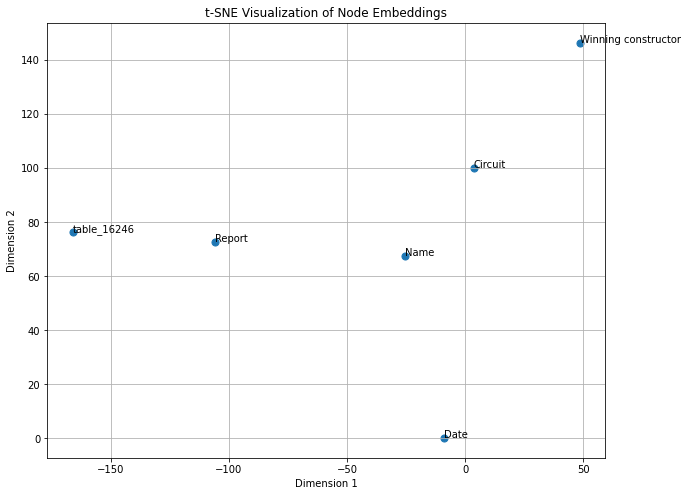

In [58]:
from sklearn.manifold import TSNE
import matplotlib.pyplot as plt

selected_nodes = list(node_embeddings.keys())
embedding_vectors = np.array([node_embeddings[node] for node in selected_nodes])

# # Extract the embedding vectors and node labels
# embedding_vectors = np.array([embedding for embedding in node_embeddings.values()])
# node_labels = list(node_embeddings.keys())


# Apply t-SNE to reduce dimensionality to 2D
tsne = TSNE(n_components=2, perplexity=1, random_state=42)
embedded_nodes = tsne.fit_transform(embedding_vectors)

# Create a scatter plot for visualization
plt.figure(figsize=(10, 8))
plt.scatter(embedded_nodes[:, 0], embedded_nodes[:, 1], marker='o', s=50)

# Annotate the points with node labels
for i, label in enumerate(selected_nodes):
    plt.annotate(label, (embedded_nodes[i, 0], embedded_nodes[i, 1]))

plt.title('t-SNE Visualization of Node Embeddings')
plt.xlabel('Dimension 1')
plt.ylabel('Dimension 2')
plt.grid(True)
plt.show()

In [55]:

# Check relations for nodes in t-SNE visualization
for node in selected_nodes:

    neighbors = list(H.neighbors(node))
    if neighbors:
        print(f'{node} is connected to: {", ".join(neighbors)}')
    else:
        print(f'{node} has no direct connections.')

table_16246 is connected to: Name, Circuit, Date, Winning driver, Winning constructor, Report
Report is connected to: table_16246
Circuit is connected to: table_16246
Winning driver is connected to: table_16246
Winning constructor is connected to: table_16246
Name is connected to: table_16246


In [18]:
# Use Node2Vec to generate embeddings for the schema
# node2vec = Node2Vec(H, dimensions=100, walk_length=10, num_walks=30)
# model = node2vec.fit(window=5, min_count=1, batch_words=4)

Computing transition probabilities:   0%|          | 0/7 [00:00<?, ?it/s]

Generating walks (CPU: 1): 100%|██████████| 30/30 [00:00<00:00, 7495.63it/s]

In [52]:
# Tokenize and preprocess the questions
tokenized_questions = [question.split() for question in questions]

In [ ]:
tokenized_questions

In [53]:
# Train Word2Vec on tokenized questions
word2vec_model = Word2Vec(tokenized_questions, vector_size=100, window=5, min_count=1, sg=0)


In [55]:
# Initialize an empty list to store combined embeddings
combined_embeddings = []

# Loop through each question and its corresponding tokens
for question, tokens in zip(questions, tokenized_questions):
    node_embeddings = []
    
    # Loop through the nodes in your schema (in this case, 'db_vocab')
    for node in db_vocab:
        # Check if the node name exists in the Word2Vec model's vocabulary
        if node in model.wv:
            node_embedding = model.wv[node]
            node_embeddings.append(node_embedding)
    
    # Filter tokens to ensure they exist in the Word2Vec model's vocabulary
    word_embeddings = [word2vec_model.wv[word] for word in tokens if word in word2vec_model.wv]
    
    # Concatenate node and word embeddings
    combined_embedding = node_embeddings + word_embeddings
    combined_embeddings.append(combined_embedding)


In [19]:
print(G)

Graph with 7 nodes and 6 edges


In [58]:
combined_embeddings[0]

[array([-0.01337051,  0.00797058,  0.00784898,  0.02173242, -0.016006  ,
        -0.01850927,  0.02742636,  0.03718856, -0.02368739, -0.01612222,
         0.02347666, -0.00391241, -0.01912109,  0.02497343, -0.01184641,
        -0.01169762,  0.02444094,  0.01608945, -0.02943761, -0.03655872,
         0.01748563, -0.00107603,  0.04689039,  0.00973538,  0.01470833,
        -0.00638141,  0.00194161,  0.0181476 , -0.02814327, -0.00326673,
         0.00236169, -0.0044245 ,  0.01596638, -0.03322249, -0.00474912,
         0.00306872,  0.02624573, -0.01881116, -0.003657  , -0.00996383,
        -0.00860241, -0.00025991, -0.02779141, -0.0130234 ,  0.01186819,
         0.01120657, -0.02004651,  0.01619337,  0.0094771 ,  0.01596842,
        -0.01001429, -0.0040459 , -0.01879285, -0.0019663 ,  0.00154996,
        -0.02228684,  0.01385519, -0.02788668, -0.01964246,  0.01001138,
        -0.0010694 , -0.00434612,  0.0065744 , -0.02588423, -0.00589102,
         0.01652766,  0.00659964,  0.0220229 , -0.0